# **Tugas Besar Generative AI**

### **Implementasi Generative Adversarial Networks (GANs)  Untuk Deteksi Tumor Otak Pada Citra MRI**

#### Beranggotakan :
##### 1. Mohammad Tri Bagus 	    (1203220155) 
##### 2. Dhimas Baharudin Satrio	(1203220016) 
##### 3. Kresna Rakhman Arief   	(1203220146) 
##### 4. Naufal Wahyu Pradana 	    (1203220157) 

### **Abstrak**
#### Generative Adversarial Networks (GANs) telah menjadi alat yang kuat dalam pencitraan medis, khususnya dalam analisis tumor otak. GANs terdiri dari dua jaringan saraf, yaitu generator dan discriminator, yang saling bersaing dalam permainan zero-sum, menghasilkan data sintetis yang realistis. Penelitian ini mengeksplorasi aplikasi GANs untuk segmentasi tumor otak, dengan fokus pada peningkatan akurasi dan efisiensi diagnosis di lingkungan klinis. Melalui GANs, data MRI dapat ditingkatkan untuk menghasilkan gambar sintetis tumor otak berkualitas tinggi, bahkan dari pemindaian resolusi rendah, memungkinkan delimitasi tumor yang lebih akurat. Pendekatan ini tidak hanya membantu ahli radiologi dalam mengidentifikasi batas-batas tumor, tetapi juga mendukung diagnosis medis otomatis, membuka jalan bagi kemajuan dalam pengobatan tumor dan perawatan pasien. 

## **1 Librarry**

In [14]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import math 
import cv2
from tqdm import tqdm
import os

## **2 Handeling Dataset** 

## **Mengumpulkan Data**

In [15]:
# Menentukan direktori dataset
dir = r'C:\Users\mohtr\.kaggle\.Tubes\brain-mri-images-for-brain-tumor-detection'
dirs = os.listdir(dir)
imshow_dirs = []

# Mengumpulkan gambar dari subdirektori
for i in dirs:
    step = os.listdir(dir + '/' + i)
    for x in range(8):
        try: 
            imshow_dirs.append(dir + '/' + i + '/' + step[x])
        except: 
            continue

### **Penjelasan** 


# **Visualisasi Data**

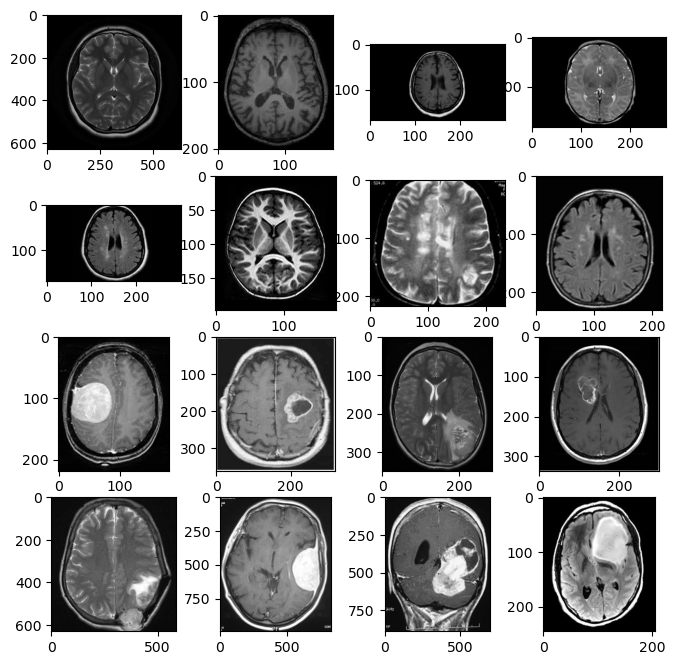

In [16]:
# Menampilkan beberapa gambar dari dataset
fig, ax = plt.subplots(4, 4, figsize=(8, 8))
for n in range(4):
    for m in range(4):
        path = imshow_dirs[m + 4 * n]
        image = cv2.imread(str(path))
        ax[n, m].imshow(image)
        ax[n, m].grid(False)

plt.show()  # Pastikan untuk menampilkan plot


# **Pengolahan Gambar**

In [17]:
X = []
Y = []
dirs = [
    r'C:\Users\mohtr\.kaggle\.Tubes\brain-mri-images-for-brain-tumor-detection/no',
    r'C:\Users\mohtr\.kaggle\.Tubes\brain-mri-images-for-brain-tumor-detection/yes'
]

for i in dirs:
    path = i
    for x in os.listdir(path):
        img = cv2.imread(path + '/' + x)
        img = cv2.resize(img, (128, 128), interpolation=cv2.INTER_AREA)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY).reshape(128, 128, 1)
        X.append(img)
        Y.append(i)

X = np.array(X)
Y = np.array(Y)
X.shape , Y.shape

((253, 128, 128, 1), (253,))

In [18]:
# Normalisasi data gambar
X = (X.astype(np.float32) - 127.5) / 127.5
X = X.reshape(X.shape[0], 128 * 128)

### **Penjelasan**


## **3 Menggunakan Metode Generative Adversarial Networks (GANs)** 

### **3.1 Nilai Referensi Penting**

In [19]:
random_dim = 100
np.random.seed(10)
image_dim = 128 * 128 * 1

### **3.2 Struktur Generator**

In [20]:
def get_generator():
    gen = tf.keras.Sequential()
    gen.add(tf.keras.layers.Dense(265, input_dim=random_dim))
    gen.add(tf.keras.layers.LeakyReLU(0.2))
    gen.add(tf.keras.layers.Dense(512))
    gen.add(tf.keras.layers.LeakyReLU(0.2))
    gen.add(tf.keras.layers.Dense(1024))
    gen.add(tf.keras.layers.LeakyReLU(0.2))
    gen.add(tf.keras.layers.Dense(image_dim, activation='tanh'))
    gen.compile(loss='binary_crossentropy', optimizer='rmsprop')
    return gen

# Menampilkan ringkasan arsitektur generator
get_generator().summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_16 (Dense)            (None, 265)               26765     
                                                                 
 leaky_re_lu_12 (LeakyReLU)  (None, 265)               0         
                                                                 
 dense_17 (Dense)            (None, 512)               136192    
                                                                 
 leaky_re_lu_13 (LeakyReLU)  (None, 512)               0         
                                                                 
 dense_18 (Dense)            (None, 1024)              525312    
                                                                 
 leaky_re_lu_14 (LeakyReLU)  (None, 1024)              0         
                                                                 
 dense_19 (Dense)            (None, 16384)            

### **Penjelasan**


### **3.3 Struktur Diskriminator**

In [21]:
def get_discriminator():
    disc = tf.keras.Sequential()
    disc.add(tf.keras.layers.Dense(1024, input_dim=image_dim))
    disc.add(tf.keras.layers.LeakyReLU(0.2))
    disc.add(tf.keras.layers.Dropout(0.3))
    disc.add(tf.keras.layers.Dense(512))
    disc.add(tf.keras.layers.LeakyReLU(0.2))
    disc.add(tf.keras.layers.Dropout(0.3))
    disc.add(tf.keras.layers.Dense(256))
    disc.add(tf.keras.layers.LeakyReLU(0.2))
    disc.add(tf.keras.layers.Dropout(0.3))
    disc.add(tf.keras.layers.Dense(1, activation='sigmoid'))
    disc.compile(loss='binary_crossentropy', optimizer='rmsprop')  
    return disc

# Menampilkan ringkasan arsitektur diskriminator
get_discriminator().summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_20 (Dense)            (None, 1024)              16778240  
                                                                 
 leaky_re_lu_15 (LeakyReLU)  (None, 1024)              0         
                                                                 
 dropout_6 (Dropout)         (None, 1024)              0         
                                                                 
 dense_21 (Dense)            (None, 512)               524800    
                                                                 
 leaky_re_lu_16 (LeakyReLU)  (None, 512)               0         
                                                                 
 dropout_7 (Dropout)         (None, 512)               0         
                                                                 
 dense_22 (Dense)            (None, 256)              

### **Penjelasan**


### **3.4 Struktur Jaringan GAN**

In [22]:
def get_gan_network(disc, gen):
    disc.trainable = False
    gan_input = tf.keras.layers.Input(shape=(random_dim))
    x = gen(gan_input)
    gan_output = disc(x)
    gan = tf.keras.models.Model(inputs=gan_input, outputs=gan_output)
    gan.compile(loss='binary_crossentropy', optimizer='adam')
    return gan

### **3.5 Fungsi Pelatihan**

In [23]:
def training(epochs=5, batch_size=128):
    batch_count = X.shape[0] / batch_size
    generator = get_generator()
    discriminator = get_discriminator()
    gan = get_gan_network(discriminator, generator)

    for epoch in range(1, epochs + 1):
        print('-' * 25, 'Epoch %d' % epoch, '-' * 25)

        for _ in tqdm(range(int(batch_count))):
            noise = np.random.normal(0, 1, size=[batch_size, random_dim])
            image_batch = X[np.random.randint(0, X.shape[0], size=batch_size)]

            generated_images = generator.predict(noise)
            concat = np.concatenate([image_batch, generated_images])

            y_dis = np.zeros(2 * batch_size)
            y_dis[:batch_size] = 0.9  # Label untuk gambar asli

            discriminator.trainable = True
            discriminator.train_on_batch(concat, y_dis)

            noise = np.random.normal(0, 1, size=[batch_size, random_dim])
            y_gen = np.ones(batch_size)  # Label untuk gambar yang dihasilkan
            discriminator.trainable = False
            gan.train_on_batch(noise, y_gen)

            if epoch == 1 or epoch % 90 == 0:
                plot_generated_images(epoch, generator)


### **3.5 Plot Fungsi Hasil GAN**

In [24]:
def plot_generated_images(epoch, generator, examples=36, dim=(6, 6), figsize=(6, 6)):
    noise = np.random.normal(0, 1, size=[examples, random_dim])
    generated_images = generator.predict(noise)
    generated_images = generated_images.reshape(examples, int(math.sqrt(image_dim)), int(math.sqrt(image_dim)))
    
    plt.figure(figsize=figsize)
    for i in range(generated_images.shape[0]):
        plt.subplot(dim[0], dim[1], i + 1)
        plt.imshow(generated_images[i], interpolation='nearest', cmap='gray_r')
        plt.axis('off')
    
    plt.tight_layout()
    plt.savefig('gan_generated_image_epoch_%d.png' % epoch)

### **3.6 Pelatihan & Hasil**

------------------------- Epoch 1 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 12ms/step


100%|██████████| 1/1 [00:04<00:00,  4.62s/it]


------------------------- Epoch 2 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 3 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 23ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 4 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 5 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:00<00:00,  1.09it/s]


------------------------- Epoch 6 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 18ms/step


100%|██████████| 1/1 [00:00<00:00,  1.19it/s]


------------------------- Epoch 7 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.21it/s]


------------------------- Epoch 8 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 17ms/step


100%|██████████| 1/1 [00:00<00:00,  1.22it/s]


------------------------- Epoch 9 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 18ms/step


100%|██████████| 1/1 [00:00<00:00,  1.18it/s]


------------------------- Epoch 10 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 17ms/step


100%|██████████| 1/1 [00:00<00:00,  1.21it/s]


------------------------- Epoch 11 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 16ms/step


100%|██████████| 1/1 [00:00<00:00,  1.25it/s]


------------------------- Epoch 12 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 18ms/step


100%|██████████| 1/1 [00:00<00:00,  1.27it/s]


------------------------- Epoch 13 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.23it/s]


------------------------- Epoch 14 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 18ms/step


100%|██████████| 1/1 [00:00<00:00,  1.23it/s]


------------------------- Epoch 15 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.19it/s]


------------------------- Epoch 16 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 18ms/step


100%|██████████| 1/1 [00:00<00:00,  1.18it/s]


------------------------- Epoch 17 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.17it/s]


------------------------- Epoch 18 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.12it/s]


------------------------- Epoch 19 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.07it/s]


------------------------- Epoch 20 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 17ms/step


100%|██████████| 1/1 [00:00<00:00,  1.16it/s]


------------------------- Epoch 21 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 17ms/step


100%|██████████| 1/1 [00:00<00:00,  1.20it/s]


------------------------- Epoch 22 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 17ms/step


100%|██████████| 1/1 [00:00<00:00,  1.20it/s]


------------------------- Epoch 23 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 17ms/step


100%|██████████| 1/1 [00:00<00:00,  1.23it/s]


------------------------- Epoch 24 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 18ms/step


100%|██████████| 1/1 [00:00<00:00,  1.25it/s]


------------------------- Epoch 25 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.25it/s]


------------------------- Epoch 26 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.17it/s]


------------------------- Epoch 27 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 18ms/step


100%|██████████| 1/1 [00:00<00:00,  1.20it/s]


------------------------- Epoch 28 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.12it/s]


------------------------- Epoch 29 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.23it/s]


------------------------- Epoch 30 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 15ms/step


100%|██████████| 1/1 [00:00<00:00,  1.22it/s]


------------------------- Epoch 31 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 17ms/step


100%|██████████| 1/1 [00:00<00:00,  1.24it/s]


------------------------- Epoch 32 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 17ms/step


100%|██████████| 1/1 [00:00<00:00,  1.23it/s]


------------------------- Epoch 33 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 18ms/step


100%|██████████| 1/1 [00:00<00:00,  1.21it/s]


------------------------- Epoch 34 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 21ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 35 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 22ms/step


100%|██████████| 1/1 [00:00<00:00,  1.07it/s]


------------------------- Epoch 36 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 37 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:00<00:00,  1.02it/s]


------------------------- Epoch 38 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


------------------------- Epoch 39 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 23ms/step


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


------------------------- Epoch 40 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 41 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.01s/it]


------------------------- Epoch 42 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


------------------------- Epoch 43 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


------------------------- Epoch 44 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 45 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 46 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:00<00:00,  1.02it/s]


------------------------- Epoch 47 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 48 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 49 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 50 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 51 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


------------------------- Epoch 52 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 53 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.00s/it]


------------------------- Epoch 54 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 55 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 56 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 57 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 58 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 59 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.01s/it]


------------------------- Epoch 60 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 22ms/step


100%|██████████| 1/1 [00:00<00:00,  1.03it/s]


------------------------- Epoch 61 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:00<00:00,  1.00it/s]


------------------------- Epoch 62 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 63 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 22ms/step


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


------------------------- Epoch 64 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


------------------------- Epoch 65 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


------------------------- Epoch 66 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 67 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


------------------------- Epoch 68 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:00<00:00,  1.03it/s]


------------------------- Epoch 69 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:00<00:00,  1.03it/s]


------------------------- Epoch 70 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:00<00:00,  1.08it/s]


------------------------- Epoch 71 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:00<00:00,  1.04it/s]


------------------------- Epoch 72 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.01s/it]


------------------------- Epoch 73 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 74 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


------------------------- Epoch 75 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 24ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 76 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 21ms/step


100%|██████████| 1/1 [00:00<00:00,  1.09it/s]


------------------------- Epoch 77 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


------------------------- Epoch 78 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 79 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 21ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 80 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


------------------------- Epoch 81 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 21ms/step


100%|██████████| 1/1 [00:00<00:00,  1.00it/s]


------------------------- Epoch 82 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 83 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 84 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


------------------------- Epoch 85 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 86 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


------------------------- Epoch 87 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 88 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 22ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 89 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 90 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 15ms/step


100%|██████████| 1/1 [00:02<00:00,  2.46s/it]


------------------------- Epoch 91 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 92 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 93 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 94 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 95 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 96 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 97 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.49s/it]


------------------------- Epoch 98 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 99 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 100 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 101 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 23ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 102 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 103 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 104 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 105 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 106 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 24ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 107 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 108 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 109 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 110 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 111 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 112 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 113 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 114 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 115 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 116 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


------------------------- Epoch 117 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 23ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 118 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 119 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 120 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 121 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 122 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 123 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 124 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 125 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 24ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 126 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 127 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


------------------------- Epoch 128 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 129 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 130 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 131 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 132 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 133 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 134 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 135 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 136 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 22ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 137 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 138 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 139 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 22ms/step


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


------------------------- Epoch 140 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 141 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 142 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 143 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 23ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 144 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 145 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 146 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 147 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


------------------------- Epoch 148 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 149 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 150 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 151 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 152 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 153 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 21ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 154 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 155 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 156 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 157 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 158 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 159 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 160 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 161 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


------------------------- Epoch 162 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.09it/s]


------------------------- Epoch 163 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


------------------------- Epoch 164 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 165 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 166 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.19it/s]


------------------------- Epoch 167 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 22ms/step


100%|██████████| 1/1 [00:00<00:00,  1.16it/s]


------------------------- Epoch 168 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 22ms/step


100%|██████████| 1/1 [00:00<00:00,  1.11it/s]


------------------------- Epoch 169 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 22ms/step


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


------------------------- Epoch 170 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:00<00:00,  1.00it/s]


------------------------- Epoch 171 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:00<00:00,  1.02it/s]


------------------------- Epoch 172 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 22ms/step


100%|██████████| 1/1 [00:00<00:00,  1.03it/s]


------------------------- Epoch 173 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 21ms/step


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


------------------------- Epoch 174 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 23ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 175 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 176 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 24ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 177 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 24ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 178 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 22ms/step


100%|██████████| 1/1 [00:00<00:00,  1.05it/s]


------------------------- Epoch 179 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.21it/s]


------------------------- Epoch 180 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 10ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 181 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 21ms/step


100%|██████████| 1/1 [00:00<00:00,  1.13it/s]


------------------------- Epoch 182 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.11it/s]


------------------------- Epoch 183 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 21ms/step


100%|██████████| 1/1 [00:00<00:00,  1.12it/s]


------------------------- Epoch 184 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 24ms/step


100%|██████████| 1/1 [00:00<00:00,  1.10it/s]


------------------------- Epoch 185 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.17it/s]


------------------------- Epoch 186 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 18ms/step


100%|██████████| 1/1 [00:00<00:00,  1.22it/s]


------------------------- Epoch 187 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 17ms/step


100%|██████████| 1/1 [00:00<00:00,  1.22it/s]


------------------------- Epoch 188 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.18it/s]


------------------------- Epoch 189 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.20it/s]


------------------------- Epoch 190 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 191 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


------------------------- Epoch 192 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 193 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 194 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 195 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 196 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 197 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 198 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 199 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 200 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 201 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 202 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 203 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 204 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 205 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 206 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 207 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 24ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 208 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 21ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 209 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 210 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 211 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 212 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 213 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 214 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 215 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 216 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 217 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 218 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.22it/s]


------------------------- Epoch 219 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 22ms/step


100%|██████████| 1/1 [00:00<00:00,  1.20it/s]


------------------------- Epoch 220 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.21it/s]


------------------------- Epoch 221 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 18ms/step


100%|██████████| 1/1 [00:00<00:00,  1.19it/s]


------------------------- Epoch 222 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 18ms/step


100%|██████████| 1/1 [00:00<00:00,  1.24it/s]


------------------------- Epoch 223 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 21ms/step


100%|██████████| 1/1 [00:00<00:00,  1.11it/s]


------------------------- Epoch 224 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.19it/s]


------------------------- Epoch 225 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.21it/s]


------------------------- Epoch 226 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.27it/s]


------------------------- Epoch 227 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 16ms/step


100%|██████████| 1/1 [00:00<00:00,  1.22it/s]


------------------------- Epoch 228 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.24it/s]


------------------------- Epoch 229 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 18ms/step


100%|██████████| 1/1 [00:00<00:00,  1.14it/s]


------------------------- Epoch 230 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 17ms/step


100%|██████████| 1/1 [00:00<00:00,  1.22it/s]


------------------------- Epoch 231 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.25it/s]


------------------------- Epoch 232 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 18ms/step


100%|██████████| 1/1 [00:00<00:00,  1.25it/s]


------------------------- Epoch 233 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.22it/s]


------------------------- Epoch 234 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 17ms/step


100%|██████████| 1/1 [00:00<00:00,  1.20it/s]


------------------------- Epoch 235 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 21ms/step


100%|██████████| 1/1 [00:00<00:00,  1.22it/s]


------------------------- Epoch 236 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 17ms/step


100%|██████████| 1/1 [00:00<00:00,  1.18it/s]


------------------------- Epoch 237 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 17ms/step


100%|██████████| 1/1 [00:00<00:00,  1.25it/s]


------------------------- Epoch 238 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.25it/s]


------------------------- Epoch 239 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 21ms/step


100%|██████████| 1/1 [00:00<00:00,  1.25it/s]


------------------------- Epoch 240 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.13it/s]


------------------------- Epoch 241 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 22ms/step


100%|██████████| 1/1 [00:00<00:00,  1.14it/s]


------------------------- Epoch 242 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 18ms/step


100%|██████████| 1/1 [00:00<00:00,  1.17it/s]


------------------------- Epoch 243 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.16it/s]


------------------------- Epoch 244 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.10it/s]


------------------------- Epoch 245 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.08it/s]


------------------------- Epoch 246 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 22ms/step


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


------------------------- Epoch 247 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.08it/s]


------------------------- Epoch 248 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 249 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.14it/s]


------------------------- Epoch 250 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.16it/s]


------------------------- Epoch 251 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:00<00:00,  1.14it/s]


------------------------- Epoch 252 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 253 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 254 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 255 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 256 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 257 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 258 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.49s/it]


------------------------- Epoch 259 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 260 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 261 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 262 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 263 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 264 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 265 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 23ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 266 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 23ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 267 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 268 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 269 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 270 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 13ms/step


100%|██████████| 1/1 [00:02<00:00,  2.92s/it]


------------------------- Epoch 271 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 272 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 273 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 274 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 275 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 276 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 277 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 278 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 279 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.46s/it]


------------------------- Epoch 280 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 281 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 282 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 283 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 284 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 285 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 23ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 286 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.51s/it]


------------------------- Epoch 287 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 288 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 289 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 290 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 291 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 292 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 293 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 294 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 295 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 296 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 297 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.49s/it]


------------------------- Epoch 298 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 299 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 300 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


------------------------- Epoch 301 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 302 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


------------------------- Epoch 303 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 304 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 305 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 306 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 307 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 308 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 309 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 310 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 311 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 312 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 313 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 314 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 315 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 316 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 317 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 318 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


------------------------- Epoch 319 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 320 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 321 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 21ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 322 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.12it/s]


------------------------- Epoch 323 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.15it/s]


------------------------- Epoch 324 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.04it/s]


------------------------- Epoch 325 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 326 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 327 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:00<00:00,  1.02it/s]


------------------------- Epoch 328 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 22ms/step


100%|██████████| 1/1 [00:00<00:00,  1.04it/s]


------------------------- Epoch 329 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 23ms/step


100%|██████████| 1/1 [00:00<00:00,  1.08it/s]


------------------------- Epoch 330 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.14it/s]


------------------------- Epoch 331 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.08it/s]


------------------------- Epoch 332 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 24ms/step


100%|██████████| 1/1 [00:00<00:00,  1.08it/s]


------------------------- Epoch 333 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 23ms/step


100%|██████████| 1/1 [00:00<00:00,  1.12it/s]


------------------------- Epoch 334 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 23ms/step


100%|██████████| 1/1 [00:00<00:00,  1.15it/s]


------------------------- Epoch 335 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 336 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 337 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 338 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 339 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 340 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 341 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 342 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 343 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 344 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 24ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 345 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 346 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 347 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 348 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 349 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 350 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 351 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 352 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 353 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 354 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 355 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 356 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 357 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 24ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 358 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 359 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 360 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 15ms/step


100%|██████████| 1/1 [00:02<00:00,  2.21s/it]


------------------------- Epoch 361 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 362 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 363 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 364 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.46s/it]


------------------------- Epoch 365 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 366 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 367 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.51s/it]


------------------------- Epoch 368 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 369 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 370 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 371 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 372 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 373 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 374 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 375 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.49s/it]


------------------------- Epoch 376 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 377 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.44s/it]


------------------------- Epoch 378 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 379 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 380 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


------------------------- Epoch 381 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 382 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 383 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 384 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


------------------------- Epoch 385 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 386 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 387 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 388 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 389 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 390 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 391 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 24ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 392 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 393 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 394 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


------------------------- Epoch 395 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 396 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 397 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 398 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 399 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 400 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 401 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 402 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 403 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 404 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 405 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 406 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 24ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 407 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 408 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 409 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 410 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 22ms/step


100%|██████████| 1/1 [00:00<00:00,  1.15it/s]


------------------------- Epoch 411 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:00<00:00,  1.05it/s]


------------------------- Epoch 412 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.15it/s]


------------------------- Epoch 413 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 21ms/step


100%|██████████| 1/1 [00:00<00:00,  1.12it/s]


------------------------- Epoch 414 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:00<00:00,  1.06it/s]


------------------------- Epoch 415 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:00<00:00,  1.03it/s]


------------------------- Epoch 416 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 21ms/step


100%|██████████| 1/1 [00:00<00:00,  1.13it/s]


------------------------- Epoch 417 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 23ms/step


100%|██████████| 1/1 [00:00<00:00,  1.07it/s]


------------------------- Epoch 418 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:00<00:00,  1.04it/s]


------------------------- Epoch 419 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 23ms/step


100%|██████████| 1/1 [00:00<00:00,  1.06it/s]


------------------------- Epoch 420 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:00<00:00,  1.10it/s]


------------------------- Epoch 421 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 422 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 423 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 424 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 425 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 426 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 427 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 428 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 429 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 430 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 431 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 432 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 433 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 434 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 435 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 436 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 437 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


------------------------- Epoch 438 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 439 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 440 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 441 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 442 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 443 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 444 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 445 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 446 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 447 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 448 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 449 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 450 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 15ms/step


100%|██████████| 1/1 [00:02<00:00,  2.33s/it]


------------------------- Epoch 451 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


------------------------- Epoch 452 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 453 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 454 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 455 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 456 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 457 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 458 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 459 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


------------------------- Epoch 460 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 461 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 462 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 463 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 464 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 465 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 466 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 467 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 468 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 469 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 470 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 471 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 472 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 473 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 474 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 475 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 476 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 477 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 478 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 479 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 480 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 481 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 482 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 483 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 484 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 485 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 486 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 487 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 488 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 489 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 490 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 491 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 492 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 493 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 494 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 495 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 496 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 497 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 498 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 499 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 500 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 501 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 502 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 503 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 504 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 505 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 506 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 507 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


------------------------- Epoch 508 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 509 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 510 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 511 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.46s/it]


------------------------- Epoch 512 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 513 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 514 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


------------------------- Epoch 515 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 516 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 517 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 518 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 519 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 520 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 521 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 522 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 523 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 524 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 525 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 526 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 527 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 528 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 75ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 529 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 530 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 531 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 532 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 533 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 534 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 535 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 536 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 537 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 538 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 539 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 540 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:02<00:00,  2.66s/it]


------------------------- Epoch 541 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 542 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 543 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 544 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 98ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 545 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 546 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 547 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 548 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 549 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 550 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 551 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 552 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 553 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 554 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 555 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 556 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 557 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 558 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 559 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 560 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 561 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 562 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 563 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 89ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 564 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 565 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


------------------------- Epoch 566 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 567 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 568 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 569 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 570 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 571 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 572 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 573 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 574 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 575 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 576 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 577 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 578 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 579 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 580 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 581 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 582 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 583 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 584 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 585 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 586 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 587 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 588 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 589 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 590 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 591 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 592 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 593 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 594 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 595 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 596 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 597 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 598 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 599 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 600 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 91ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 601 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 602 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 603 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 604 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 605 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 606 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 607 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 608 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 609 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 610 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 611 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 612 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 613 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 614 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 615 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 616 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 617 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 618 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 619 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 620 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 621 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 622 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 623 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 624 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 625 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 626 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 627 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 628 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 629 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 630 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:02<00:00,  2.31s/it]


------------------------- Epoch 631 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 632 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 633 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 634 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 635 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 636 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.46s/it]


------------------------- Epoch 637 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 638 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 639 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 640 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 641 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 642 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 643 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 644 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 645 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 646 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 647 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 648 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 649 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 650 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 651 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


------------------------- Epoch 652 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 653 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 654 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 655 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 656 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 657 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 658 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 659 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 660 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 661 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 662 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 663 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 664 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 665 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 666 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 667 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 668 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 669 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 670 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 671 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 672 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 673 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 674 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 675 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 676 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 677 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 678 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 679 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 680 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 681 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 682 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


------------------------- Epoch 683 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 684 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 685 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 686 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 687 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 688 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 689 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 690 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 66ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 691 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 692 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 693 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 694 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 695 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 696 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 697 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 698 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 699 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 700 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 701 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 702 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 703 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 704 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 705 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 706 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 707 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 708 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 709 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 710 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 711 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 712 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 713 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 714 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 715 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 716 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 717 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 718 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 719 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 720 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 17ms/step


100%|██████████| 1/1 [00:02<00:00,  2.79s/it]


------------------------- Epoch 721 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.49s/it]


------------------------- Epoch 722 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 723 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 724 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 725 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.44s/it]


------------------------- Epoch 726 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 727 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 728 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 729 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 730 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 731 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


------------------------- Epoch 732 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 733 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 734 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 735 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 736 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 737 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 738 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 739 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 740 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 741 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 742 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 743 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 744 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 745 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 746 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 747 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 748 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 749 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 750 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 751 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 752 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 753 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 754 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 755 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 756 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 757 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 758 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


------------------------- Epoch 759 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 760 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 761 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 762 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 763 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 764 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 765 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 766 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 767 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 768 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 769 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 770 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 771 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 772 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 773 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 774 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 775 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


------------------------- Epoch 776 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 777 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


------------------------- Epoch 778 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 779 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 780 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 781 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 65ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 782 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 783 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 784 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 785 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 786 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 787 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 87ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 788 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 789 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 790 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 791 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 792 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


------------------------- Epoch 793 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 794 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 795 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 796 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 797 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 798 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 799 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 800 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 801 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 802 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 803 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 804 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 805 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


------------------------- Epoch 806 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 807 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 808 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 809 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 810 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:04<00:00,  4.01s/it]


------------------------- Epoch 811 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 812 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 813 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 814 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 815 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 816 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 817 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 818 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 819 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 820 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 821 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 822 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 823 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.77s/it]


------------------------- Epoch 824 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 825 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 826 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 827 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.44s/it]


------------------------- Epoch 828 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 829 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 830 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 831 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 832 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 833 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 834 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 835 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 836 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 837 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 838 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 839 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 840 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 841 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 842 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 843 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.88s/it]


------------------------- Epoch 844 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 845 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 846 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 847 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 848 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


------------------------- Epoch 849 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 850 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 851 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 852 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 853 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 854 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.85s/it]


------------------------- Epoch 855 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.78s/it]


------------------------- Epoch 856 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 857 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 858 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 859 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.44s/it]


------------------------- Epoch 860 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.79s/it]


------------------------- Epoch 861 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


------------------------- Epoch 862 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 863 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 864 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 117ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 865 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 866 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 867 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 868 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 869 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


------------------------- Epoch 870 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 69ms/step


100%|██████████| 1/1 [00:01<00:00,  1.77s/it]


------------------------- Epoch 871 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 872 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 873 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  2.00s/it]


------------------------- Epoch 874 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 875 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 876 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 877 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 878 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 879 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 880 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 881 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 882 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 883 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 884 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.46s/it]


------------------------- Epoch 885 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 886 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 887 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 888 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.49s/it]


------------------------- Epoch 889 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 890 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 891 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 892 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 893 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


------------------------- Epoch 894 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 895 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 896 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 897 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.94s/it]


------------------------- Epoch 898 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 899 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


------------------------- Epoch 900 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 21ms/step


100%|██████████| 1/1 [00:03<00:00,  3.13s/it]


------------------------- Epoch 901 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.78s/it]


------------------------- Epoch 902 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 903 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 904 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 905 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 906 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 907 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 908 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 909 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 910 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.46s/it]


------------------------- Epoch 911 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 912 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


------------------------- Epoch 913 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 914 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 915 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 916 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


------------------------- Epoch 917 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 918 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 919 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 920 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 921 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 922 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 923 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 924 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 925 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 926 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 927 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 928 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 929 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 930 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 931 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 932 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 933 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 934 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 935 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 936 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 937 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 938 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 939 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 940 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 941 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 942 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 943 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


------------------------- Epoch 944 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


------------------------- Epoch 945 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 946 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 947 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 948 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 949 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 950 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.51s/it]


------------------------- Epoch 951 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 952 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 953 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 954 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 955 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 956 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 957 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 958 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 959 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 960 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 961 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 962 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 963 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:02<00:00,  2.08s/it]


------------------------- Epoch 964 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


------------------------- Epoch 965 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 966 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 967 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 968 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 79ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 969 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 970 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.49s/it]


------------------------- Epoch 971 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 972 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 973 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 974 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 975 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 976 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 977 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 978 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 979 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 980 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 981 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 982 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


------------------------- Epoch 983 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


------------------------- Epoch 984 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


------------------------- Epoch 985 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


------------------------- Epoch 986 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:00<00:00,  1.02it/s]


------------------------- Epoch 987 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 988 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:00<00:00,  1.05it/s]


------------------------- Epoch 989 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


------------------------- Epoch 990 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 10ms/step


100%|██████████| 1/1 [00:01<00:00,  1.98s/it]


------------------------- Epoch 991 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.01s/it]


------------------------- Epoch 992 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 993 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


------------------------- Epoch 994 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


------------------------- Epoch 995 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 996 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


------------------------- Epoch 997 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 998 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 999 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1000 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.00s/it]


------------------------- Epoch 1001 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.01s/it]


------------------------- Epoch 1002 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1003 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.01s/it]


------------------------- Epoch 1004 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


------------------------- Epoch 1005 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1006 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


------------------------- Epoch 1007 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1008 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.00s/it]


------------------------- Epoch 1009 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.01s/it]


------------------------- Epoch 1010 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


------------------------- Epoch 1011 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


------------------------- Epoch 1012 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


------------------------- Epoch 1013 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


------------------------- Epoch 1014 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:00<00:00,  1.02it/s]


------------------------- Epoch 1015 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.00s/it]


------------------------- Epoch 1016 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 1017 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


------------------------- Epoch 1018 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


------------------------- Epoch 1019 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1020 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.00s/it]


------------------------- Epoch 1021 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1022 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


------------------------- Epoch 1023 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.00s/it]


------------------------- Epoch 1024 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.00s/it]


------------------------- Epoch 1025 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1026 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


------------------------- Epoch 1027 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1028 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.00s/it]


------------------------- Epoch 1029 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.01s/it]


------------------------- Epoch 1030 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 1031 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


------------------------- Epoch 1032 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 1033 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:00<00:00,  1.03it/s]


------------------------- Epoch 1034 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:00<00:00,  1.02it/s]


------------------------- Epoch 1035 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


------------------------- Epoch 1036 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 1037 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:00<00:00,  1.00it/s]


------------------------- Epoch 1038 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


------------------------- Epoch 1039 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:00<00:00,  1.02it/s]


------------------------- Epoch 1040 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:00<00:00,  1.02it/s]


------------------------- Epoch 1041 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


------------------------- Epoch 1042 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.01s/it]


------------------------- Epoch 1043 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.01s/it]


------------------------- Epoch 1044 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 1045 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.01s/it]


------------------------- Epoch 1046 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:00<00:00,  1.00it/s]


------------------------- Epoch 1047 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1048 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1049 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1050 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 1051 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 1052 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:02<00:00,  2.07s/it]


------------------------- Epoch 1053 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 1054 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 1055 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 1056 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 1057 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 1058 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 1059 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 1060 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 1061 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 1062 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 1063 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 1064 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 1065 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 1066 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 1067 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:01<00:00,  1.85s/it]


------------------------- Epoch 1068 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 70ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 1069 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 1070 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.77s/it]


------------------------- Epoch 1071 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 1072 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 1073 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 1074 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 68ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 1075 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 1076 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 1077 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 68ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 1078 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.49s/it]


------------------------- Epoch 1079 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 1080 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 14ms/step


100%|██████████| 1/1 [00:02<00:00,  2.84s/it]


------------------------- Epoch 1081 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 1082 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 1083 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 1084 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 1085 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 1086 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


------------------------- Epoch 1087 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.49s/it]


------------------------- Epoch 1088 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.51s/it]


------------------------- Epoch 1089 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 1090 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 1091 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 1092 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 1093 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 1094 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


------------------------- Epoch 1095 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


------------------------- Epoch 1096 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 1097 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 1098 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 1099 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.44s/it]


------------------------- Epoch 1100 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 1101 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


------------------------- Epoch 1102 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 1103 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 1104 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 1105 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 1106 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 1107 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 1108 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 1109 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:01<00:00,  1.77s/it]


------------------------- Epoch 1110 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 1111 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 1112 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 1113 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:01<00:00,  1.81s/it]


------------------------- Epoch 1114 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 1115 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 1116 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 1117 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 1118 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 1119 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 1120 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 1121 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 1122 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 1123 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 1124 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 1125 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 1126 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 1127 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:01<00:00,  1.81s/it]


------------------------- Epoch 1128 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 1129 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 1130 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 1131 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 1132 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 1133 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 1134 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 1135 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 1136 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 1137 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 1138 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 1139 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 1140 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 1141 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 82ms/step


100%|██████████| 1/1 [00:01<00:00,  1.78s/it]


------------------------- Epoch 1142 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 68ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 1143 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 1144 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 1145 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 1146 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 1147 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.44s/it]


------------------------- Epoch 1148 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 1149 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


------------------------- Epoch 1150 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 1151 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 1152 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 1153 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.49s/it]


------------------------- Epoch 1154 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 1155 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 1156 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 1157 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 1158 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 1159 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 1160 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 1161 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 1162 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


------------------------- Epoch 1163 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 1164 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 1165 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 1166 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 1167 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 1168 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 1169 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 1170 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:02<00:00,  2.68s/it]


------------------------- Epoch 1171 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.51s/it]


------------------------- Epoch 1172 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 70ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 1173 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


------------------------- Epoch 1174 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 1175 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 70ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 1176 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 1177 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 1178 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 1179 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 75ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 1180 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 1181 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 1182 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 84ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 1183 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 68ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 1184 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 1185 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 1186 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 1187 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 1188 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 1189 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 1190 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 1191 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 1192 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 1193 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 65ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 1194 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 1195 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 1196 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 1197 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 1198 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 1199 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 1200 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 1201 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 1202 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 1203 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.90s/it]


------------------------- Epoch 1204 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 1205 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 1206 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 1207 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1208 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1209 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 1210 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 1211 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1212 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1213 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1214 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 1215 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 1216 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1217 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1218 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1219 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1220 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1221 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1222 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1223 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1224 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1225 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1226 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1227 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1228 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1229 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1230 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1231 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1232 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 1233 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1234 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1235 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1236 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


------------------------- Epoch 1237 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1238 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1239 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1240 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1241 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1242 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1243 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 1244 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1245 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1246 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 1247 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


------------------------- Epoch 1248 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1249 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1250 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


------------------------- Epoch 1251 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.90s/it]


------------------------- Epoch 1252 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 1253 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 1254 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 1255 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 1256 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 1257 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 1258 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1259 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.51s/it]


------------------------- Epoch 1260 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 11ms/step


100%|██████████| 1/1 [00:02<00:00,  2.36s/it]


------------------------- Epoch 1261 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 1262 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 1263 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1264 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1265 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1266 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1267 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1268 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 1269 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 1270 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 76ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 1271 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 1272 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 1273 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 1274 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 1275 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1276 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1277 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1278 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 107ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 1279 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1280 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1281 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1282 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 1283 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 1284 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 1285 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 1286 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 1287 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1288 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 1289 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 1290 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 1291 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 1292 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1293 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1294 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1295 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1296 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1297 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1298 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 1299 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 1300 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 1301 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 1302 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1303 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1304 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1305 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 1306 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1307 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1308 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 1309 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1310 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1311 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1312 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 101ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 1313 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1314 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1315 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1316 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1317 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1318 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1319 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1320 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1321 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1322 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1323 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1324 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 1325 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1326 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1327 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1328 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1329 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1330 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1331 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1332 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1333 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1334 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1335 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1336 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1337 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 1338 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 1339 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1340 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1341 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1342 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1343 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


------------------------- Epoch 1344 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 1345 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1346 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 1347 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 1348 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1349 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1350 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 10ms/step


100%|██████████| 1/1 [00:01<00:00,  1.81s/it]


------------------------- Epoch 1351 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1352 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1353 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1354 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1355 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1356 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1357 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1358 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1359 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1360 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1361 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1362 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1363 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1364 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 1365 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 1366 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1367 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1368 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1369 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1370 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1371 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1372 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 1373 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1374 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


------------------------- Epoch 1375 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1376 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1377 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 1378 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


------------------------- Epoch 1379 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1380 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1381 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1382 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1383 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1384 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1385 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1386 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1387 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1388 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 1389 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 1390 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1391 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1392 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1393 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1394 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1395 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1396 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1397 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1398 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1399 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1400 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 1401 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


------------------------- Epoch 1402 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1403 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1404 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1405 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1406 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1407 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1408 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1409 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1410 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1411 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1412 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1413 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1414 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1415 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 113ms/step


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


------------------------- Epoch 1416 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 1417 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 1418 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 1419 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 1420 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.44s/it]


------------------------- Epoch 1421 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.51s/it]


------------------------- Epoch 1422 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 1423 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1424 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 1425 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 1426 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1427 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1428 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1429 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1430 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1431 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1432 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 1433 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1434 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1435 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1436 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1437 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1438 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1439 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1440 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 10ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 1441 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1442 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1443 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1444 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1445 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 1446 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 1447 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1448 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1449 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.49s/it]


------------------------- Epoch 1450 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.49s/it]


------------------------- Epoch 1451 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 1452 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1453 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1454 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1455 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 1456 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1457 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 1458 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1459 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1460 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1461 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1462 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1463 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1464 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1465 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1466 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1467 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1468 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 1469 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1470 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1471 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1472 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1473 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1474 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1475 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 1476 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1477 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1478 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 1479 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1480 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1481 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1482 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1483 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1484 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1485 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 1486 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 1487 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 1488 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1489 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1490 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1491 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1492 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1493 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 25ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1494 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 1495 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 1496 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 1497 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 1498 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 1499 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1500 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1501 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 1502 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1503 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 1504 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1505 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1506 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1507 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1508 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1509 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1510 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1511 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1512 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1513 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1514 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1515 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1516 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1517 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1518 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1519 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1520 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1521 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1522 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1523 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1524 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 1525 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 1526 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1527 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1528 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1529 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1530 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 1531 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1532 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 1533 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 1534 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1535 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1536 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 138ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 1537 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1538 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 1539 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1540 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1541 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1542 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1543 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1544 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1545 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1546 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1547 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1548 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1549 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1550 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 1551 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 1552 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1553 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1554 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1555 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1556 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1557 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1558 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 1559 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1560 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1561 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1562 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1563 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 1564 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1565 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1566 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1567 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 1568 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 1569 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 1570 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1571 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 1572 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 1573 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1574 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 1575 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 1576 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1577 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1578 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 115ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 1579 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1580 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1581 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1582 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1583 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1584 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1585 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 1586 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 1587 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 1588 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


------------------------- Epoch 1589 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 1590 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 1591 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


------------------------- Epoch 1592 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1593 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 1594 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


------------------------- Epoch 1595 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 1596 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1597 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1598 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 1599 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 1600 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 1601 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 1602 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 1603 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1604 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1605 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1606 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1607 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1608 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1609 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1610 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1611 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1612 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 1613 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 1614 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 1615 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1616 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1617 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1618 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 1619 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1620 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:02<00:00,  2.17s/it]


------------------------- Epoch 1621 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1622 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 1623 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1624 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1625 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 1626 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1627 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1628 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1629 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1630 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1631 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1632 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1633 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1634 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1635 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1636 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1637 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1638 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1639 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1640 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1641 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1642 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1643 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1644 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


------------------------- Epoch 1645 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1646 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1647 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 1648 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 1649 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 1650 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1651 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1652 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1653 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1654 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 1655 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1656 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1657 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 26ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1658 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1659 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1660 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1661 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1662 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1663 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1664 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1665 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1666 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1667 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1668 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1669 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1670 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1671 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1672 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1673 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1674 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1675 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1676 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1677 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1678 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1679 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1680 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1681 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


------------------------- Epoch 1682 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1683 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1684 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 28ms/step


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


------------------------- Epoch 1685 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1686 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1687 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1688 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


------------------------- Epoch 1689 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1690 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 1691 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 1692 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 1693 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1694 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 1695 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.51s/it]


------------------------- Epoch 1696 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


------------------------- Epoch 1697 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


------------------------- Epoch 1698 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


------------------------- Epoch 1699 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 1700 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 1701 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 1702 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 1703 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 1704 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 1705 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


------------------------- Epoch 1706 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 64ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 1707 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.10s/it]


------------------------- Epoch 1708 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1709 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


------------------------- Epoch 1710 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 10ms/step


100%|██████████| 1/1 [00:02<00:00,  2.27s/it]


------------------------- Epoch 1711 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 1712 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1713 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1714 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1715 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1716 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1717 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 29ms/step


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


------------------------- Epoch 1718 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


------------------------- Epoch 1719 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1720 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 1721 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 1722 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 1723 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 1724 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 1725 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 1726 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.88s/it]


------------------------- Epoch 1727 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 1728 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 1729 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 1730 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 1731 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 1732 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 1733 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.78s/it]


------------------------- Epoch 1734 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 1735 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 1736 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 1737 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 1738 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.46s/it]


------------------------- Epoch 1739 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.85s/it]


------------------------- Epoch 1740 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 1741 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 1742 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 1743 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 1744 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 1745 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.46s/it]


------------------------- Epoch 1746 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 1747 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.44s/it]


------------------------- Epoch 1748 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 1749 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 1750 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 1751 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 1752 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 1753 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 1754 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 1755 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 1756 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1757 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1758 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 1759 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 1760 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1761 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1762 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1763 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1764 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1765 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1766 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


------------------------- Epoch 1767 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1768 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 27ms/step


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


------------------------- Epoch 1769 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


------------------------- Epoch 1770 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 1771 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


------------------------- Epoch 1772 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 1773 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 82ms/step


100%|██████████| 1/1 [00:01<00:00,  1.81s/it]


------------------------- Epoch 1774 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


------------------------- Epoch 1775 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.96s/it]


------------------------- Epoch 1776 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 1777 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 1778 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:02<00:00,  2.08s/it]


------------------------- Epoch 1779 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 1780 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 1781 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 1782 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


------------------------- Epoch 1783 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 1784 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 1785 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 1786 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 1787 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 1788 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 1789 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.88s/it]


------------------------- Epoch 1790 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 1791 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 1792 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 1793 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 1794 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


------------------------- Epoch 1795 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 1796 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.44s/it]


------------------------- Epoch 1797 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 1798 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 1799 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 1800 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 20ms/step


C:\Users\mohtr\AppData\Local\Temp\ipykernel_12604\2079626440.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=figsize)
100%|██████████| 1/1 [00:03<00:00,  3.34s/it]


------------------------- Epoch 1801 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.51s/it]


------------------------- Epoch 1802 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 1803 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 1804 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 1805 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 1806 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 1807 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.78s/it]


------------------------- Epoch 1808 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 1809 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 1810 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 1811 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 1812 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 1813 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 1814 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 1815 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 1816 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 1817 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 1818 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 1819 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.77s/it]


------------------------- Epoch 1820 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.81s/it]


------------------------- Epoch 1821 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.88s/it]


------------------------- Epoch 1822 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 1823 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 1824 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 1825 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 1826 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 1827 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 1828 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 1829 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 1830 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 1831 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 1832 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 1833 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 1834 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 1835 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 1836 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 1837 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 1838 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 1839 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 1840 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 1841 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 1842 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 1843 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 1844 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 1845 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 1846 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 1847 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 1848 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 1849 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 1850 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 1851 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 1852 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1853 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


------------------------- Epoch 1854 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 1855 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


------------------------- Epoch 1856 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 1857 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 30ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 1858 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 1859 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 1860 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 1861 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 1862 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 1863 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.51s/it]


------------------------- Epoch 1864 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 1865 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 1866 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 1867 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 1868 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 1869 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 1870 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 1871 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 1872 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 1873 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


------------------------- Epoch 1874 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 1875 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.46s/it]


------------------------- Epoch 1876 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 1877 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


------------------------- Epoch 1878 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 1879 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 1880 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.49s/it]


------------------------- Epoch 1881 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 1882 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 1883 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 1884 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 1885 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 1886 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 1887 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 1888 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 1889 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 1890 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:02<00:00,  2.68s/it]


------------------------- Epoch 1891 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 1892 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 1893 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 1894 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 1895 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 1896 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.51s/it]


------------------------- Epoch 1897 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 1898 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.78s/it]


------------------------- Epoch 1899 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 1900 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 1901 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 1902 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 1903 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 1904 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


------------------------- Epoch 1905 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1906 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 1907 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 1908 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 1909 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 1910 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


------------------------- Epoch 1911 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 1912 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 1913 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 1914 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 1915 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.46s/it]


------------------------- Epoch 1916 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.81s/it]


------------------------- Epoch 1917 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 1918 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


------------------------- Epoch 1919 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 1920 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.44s/it]


------------------------- Epoch 1921 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 1922 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 1923 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 1924 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 1925 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 1926 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 66ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 1927 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 1928 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 1929 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 106ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 1930 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


------------------------- Epoch 1931 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 1932 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 1933 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1934 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1935 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 1936 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 1937 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 1938 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 1939 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 1940 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 1941 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 1942 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 1943 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 1944 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 1945 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 1946 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 1947 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1948 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 1949 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 1950 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


------------------------- Epoch 1951 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 1952 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 1953 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 1954 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1955 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 1956 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.44s/it]


------------------------- Epoch 1957 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1958 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 32ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 1959 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 34ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 1960 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 1961 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 1962 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 1963 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


------------------------- Epoch 1964 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1965 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 1966 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 1967 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 1968 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 1969 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


------------------------- Epoch 1970 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 1971 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 1972 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1973 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 1974 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 1975 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 1976 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 1977 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 132ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 1978 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.46s/it]


------------------------- Epoch 1979 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 1980 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 15ms/step


100%|██████████| 1/1 [00:02<00:00,  2.28s/it]


------------------------- Epoch 1981 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 1982 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 1983 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 1984 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 1985 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 1986 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 1987 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 1988 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 1989 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 1990 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 1991 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 1992 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.46s/it]


------------------------- Epoch 1993 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 1994 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 1995 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 1996 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 1997 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 1998 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.46s/it]


------------------------- Epoch 1999 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 2000 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


------------------------- Epoch 2001 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 2002 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 2003 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 2004 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 2005 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 2006 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 2007 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 2008 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 2009 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 2010 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 2011 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2012 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.79s/it]


------------------------- Epoch 2013 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 2014 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 2015 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 2016 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.46s/it]


------------------------- Epoch 2017 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 2018 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.46s/it]


------------------------- Epoch 2019 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 2020 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 2021 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2022 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 2023 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 2024 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 2025 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


------------------------- Epoch 2026 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2027 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 2028 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 65ms/step


100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


------------------------- Epoch 2029 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 2030 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2031 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.77s/it]


------------------------- Epoch 2032 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 2033 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 2034 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2035 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.85s/it]


------------------------- Epoch 2036 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 2037 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.78s/it]


------------------------- Epoch 2038 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 2039 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 2040 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 2041 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.90s/it]


------------------------- Epoch 2042 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 2043 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


------------------------- Epoch 2044 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 2045 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


------------------------- Epoch 2046 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 2047 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 2048 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.96s/it]


------------------------- Epoch 2049 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 2050 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 2051 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


------------------------- Epoch 2052 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


------------------------- Epoch 2053 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 2054 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 2055 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 2056 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 2057 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2058 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.77s/it]


------------------------- Epoch 2059 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 2060 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 2061 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 2062 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 2063 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 2064 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 2065 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 68ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2066 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 2067 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 2068 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 2069 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 2070 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 22ms/step


100%|██████████| 1/1 [00:02<00:00,  2.83s/it]


------------------------- Epoch 2071 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.51s/it]


------------------------- Epoch 2072 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 2073 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2074 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2075 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2076 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 2077 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.91s/it]


------------------------- Epoch 2078 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.81s/it]


------------------------- Epoch 2079 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


------------------------- Epoch 2080 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 2081 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 2082 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 2083 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 2084 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 2085 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 2086 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 2087 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 2088 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 2089 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.90s/it]


------------------------- Epoch 2090 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 72ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 2091 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2092 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2093 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 2094 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 2095 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


------------------------- Epoch 2096 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 2097 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 2098 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 2099 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 2100 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


------------------------- Epoch 2101 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 2102 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 2103 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


------------------------- Epoch 2104 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 2105 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 2106 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 2107 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 2108 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 2109 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 2110 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 2111 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


------------------------- Epoch 2112 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


------------------------- Epoch 2113 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


------------------------- Epoch 2114 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.51s/it]


------------------------- Epoch 2115 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


------------------------- Epoch 2116 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 2117 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 2118 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:01<00:00,  1.77s/it]


------------------------- Epoch 2119 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 2120 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 2121 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2122 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2123 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 2124 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.79s/it]


------------------------- Epoch 2125 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 2126 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2127 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 2128 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 2129 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 2130 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 66ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 2131 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2132 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:01<00:00,  1.96s/it]


------------------------- Epoch 2133 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.79s/it]


------------------------- Epoch 2134 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.81s/it]


------------------------- Epoch 2135 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 2136 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 2137 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.81s/it]


------------------------- Epoch 2138 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 2139 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 2140 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 2141 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.78s/it]


------------------------- Epoch 2142 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 33ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 2143 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


------------------------- Epoch 2144 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 2145 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


------------------------- Epoch 2146 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 2147 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 2148 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 2149 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


------------------------- Epoch 2150 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 2151 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


------------------------- Epoch 2152 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 64ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 2153 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.21s/it]


------------------------- Epoch 2154 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


------------------------- Epoch 2155 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 2156 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 2157 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 2158 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 2159 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


------------------------- Epoch 2160 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:02<00:00,  2.97s/it]


------------------------- Epoch 2161 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 65ms/step


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


------------------------- Epoch 2162 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 2163 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


------------------------- Epoch 2164 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


------------------------- Epoch 2165 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 2166 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


------------------------- Epoch 2167 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


------------------------- Epoch 2168 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


------------------------- Epoch 2169 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 2170 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 2171 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 36ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 2172 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 2173 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 2174 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


------------------------- Epoch 2175 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


------------------------- Epoch 2176 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


------------------------- Epoch 2177 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 2178 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


------------------------- Epoch 2179 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 2180 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


------------------------- Epoch 2181 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 38ms/step


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


------------------------- Epoch 2182 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


------------------------- Epoch 2183 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


------------------------- Epoch 2184 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 35ms/step


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


------------------------- Epoch 2185 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 2186 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 2187 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2188 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2189 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 2190 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 2191 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 2192 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 2193 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 2194 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 2195 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 2196 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 2197 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 2198 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 2199 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 2200 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 2201 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 2202 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 2203 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 2204 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2205 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 2206 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2207 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 2208 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2209 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 2210 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.96s/it]


------------------------- Epoch 2211 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 2212 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 2213 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 2214 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 2215 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:02<00:00,  2.03s/it]


------------------------- Epoch 2216 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


------------------------- Epoch 2217 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 2218 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 2219 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 2220 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2221 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 2222 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 2223 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 2224 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 2225 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2226 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 2227 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 2228 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 2229 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


------------------------- Epoch 2230 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 2231 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:02<00:00,  2.09s/it]


------------------------- Epoch 2232 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2233 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 2234 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 77ms/step


100%|██████████| 1/1 [00:01<00:00,  1.94s/it]


------------------------- Epoch 2235 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


------------------------- Epoch 2236 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.90s/it]


------------------------- Epoch 2237 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 37ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 2238 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:02<00:00,  2.22s/it]


------------------------- Epoch 2239 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:02<00:00,  2.15s/it]


------------------------- Epoch 2240 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:02<00:00,  2.13s/it]


------------------------- Epoch 2241 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:02<00:00,  2.15s/it]


------------------------- Epoch 2242 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:02<00:00,  2.22s/it]


------------------------- Epoch 2243 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:02<00:00,  2.08s/it]


------------------------- Epoch 2244 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2245 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:02<00:00,  2.06s/it]


------------------------- Epoch 2246 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


------------------------- Epoch 2247 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 77ms/step


100%|██████████| 1/1 [00:02<00:00,  2.11s/it]


------------------------- Epoch 2248 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.16s/it]


------------------------- Epoch 2249 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:02<00:00,  2.01s/it]


------------------------- Epoch 2250 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 15ms/step


100%|██████████| 1/1 [00:03<00:00,  3.27s/it]


------------------------- Epoch 2251 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 2252 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 74ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2253 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:02<00:00,  2.03s/it]


------------------------- Epoch 2254 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:02<00:00,  2.08s/it]


------------------------- Epoch 2255 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.98s/it]


------------------------- Epoch 2256 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:02<00:00,  2.19s/it]


------------------------- Epoch 2257 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:02<00:00,  2.17s/it]


------------------------- Epoch 2258 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 87ms/step


100%|██████████| 1/1 [00:02<00:00,  2.11s/it]


------------------------- Epoch 2259 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.90s/it]


------------------------- Epoch 2260 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:02<00:00,  2.00s/it]


------------------------- Epoch 2261 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.91s/it]


------------------------- Epoch 2262 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2263 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


------------------------- Epoch 2264 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2265 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2266 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.94s/it]


------------------------- Epoch 2267 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:02<00:00,  2.11s/it]


------------------------- Epoch 2268 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.96s/it]


------------------------- Epoch 2269 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2270 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2271 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.91s/it]


------------------------- Epoch 2272 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.90s/it]


------------------------- Epoch 2273 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.94s/it]


------------------------- Epoch 2274 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2275 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 66ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2276 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 2277 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2278 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.79s/it]


------------------------- Epoch 2279 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 2280 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2281 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2282 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


------------------------- Epoch 2283 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2284 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2285 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 74ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 2286 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:02<00:00,  2.00s/it]


------------------------- Epoch 2287 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2288 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2289 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.14s/it]


------------------------- Epoch 2290 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:02<00:00,  2.03s/it]


------------------------- Epoch 2291 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2292 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2293 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.13s/it]


------------------------- Epoch 2294 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.12s/it]


------------------------- Epoch 2295 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 64ms/step


100%|██████████| 1/1 [00:02<00:00,  2.02s/it]


------------------------- Epoch 2296 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:02<00:00,  2.18s/it]


------------------------- Epoch 2297 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2298 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:02<00:00,  2.11s/it]


------------------------- Epoch 2299 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 2300 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


------------------------- Epoch 2301 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  2.00s/it]


------------------------- Epoch 2302 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


------------------------- Epoch 2303 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2304 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.96s/it]


------------------------- Epoch 2305 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2306 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2307 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.90s/it]


------------------------- Epoch 2308 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:02<00:00,  2.02s/it]


------------------------- Epoch 2309 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.90s/it]


------------------------- Epoch 2310 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2311 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.78s/it]


------------------------- Epoch 2312 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2313 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 2314 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2315 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2316 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:02<00:00,  2.01s/it]


------------------------- Epoch 2317 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 2318 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 2319 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.85s/it]


------------------------- Epoch 2320 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2321 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 2322 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:02<00:00,  2.03s/it]


------------------------- Epoch 2323 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:02<00:00,  2.01s/it]


------------------------- Epoch 2324 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2325 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  2.00s/it]


------------------------- Epoch 2326 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.94s/it]


------------------------- Epoch 2327 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


------------------------- Epoch 2328 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.98s/it]


------------------------- Epoch 2329 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:02<00:00,  2.06s/it]


------------------------- Epoch 2330 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.94s/it]


------------------------- Epoch 2331 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2332 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2333 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.96s/it]


------------------------- Epoch 2334 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2335 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:02<00:00,  2.00s/it]


------------------------- Epoch 2336 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:02<00:00,  2.02s/it]


------------------------- Epoch 2337 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2338 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:02<00:00,  2.01s/it]


------------------------- Epoch 2339 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:02<00:00,  2.07s/it]


------------------------- Epoch 2340 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 23ms/step


100%|██████████| 1/1 [00:03<00:00,  3.31s/it]


------------------------- Epoch 2341 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2342 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


------------------------- Epoch 2343 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2344 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2345 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.98s/it]


------------------------- Epoch 2346 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:02<00:00,  2.11s/it]


------------------------- Epoch 2347 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 75ms/step


100%|██████████| 1/1 [00:02<00:00,  2.16s/it]


------------------------- Epoch 2348 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:02<00:00,  2.02s/it]


------------------------- Epoch 2349 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 70ms/step


100%|██████████| 1/1 [00:02<00:00,  2.11s/it]


------------------------- Epoch 2350 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2351 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:02<00:00,  2.01s/it]


------------------------- Epoch 2352 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:02<00:00,  2.16s/it]


------------------------- Epoch 2353 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:02<00:00,  2.07s/it]


------------------------- Epoch 2354 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.16s/it]


------------------------- Epoch 2355 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2356 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.98s/it]


------------------------- Epoch 2357 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2358 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 70ms/step


100%|██████████| 1/1 [00:02<00:00,  2.24s/it]


------------------------- Epoch 2359 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:02<00:00,  2.01s/it]


------------------------- Epoch 2360 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:02<00:00,  2.20s/it]


------------------------- Epoch 2361 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 72ms/step


100%|██████████| 1/1 [00:01<00:00,  1.90s/it]


------------------------- Epoch 2362 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:01<00:00,  1.79s/it]


------------------------- Epoch 2363 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 76ms/step


100%|██████████| 1/1 [00:02<00:00,  2.28s/it]


------------------------- Epoch 2364 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 92ms/step


100%|██████████| 1/1 [00:02<00:00,  2.09s/it]


------------------------- Epoch 2365 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2366 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:02<00:00,  2.14s/it]


------------------------- Epoch 2367 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 91ms/step


100%|██████████| 1/1 [00:02<00:00,  2.08s/it]


------------------------- Epoch 2368 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.85s/it]


------------------------- Epoch 2369 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.96s/it]


------------------------- Epoch 2370 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


------------------------- Epoch 2371 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2372 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2373 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.85s/it]


------------------------- Epoch 2374 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 78ms/step


100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


------------------------- Epoch 2375 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.81s/it]


------------------------- Epoch 2376 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2377 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


------------------------- Epoch 2378 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


------------------------- Epoch 2379 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 2380 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 2381 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 2382 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 2383 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 2384 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 2385 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 2386 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 2387 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 72ms/step


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]


------------------------- Epoch 2388 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.78s/it]


------------------------- Epoch 2389 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.51s/it]


------------------------- Epoch 2390 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 2391 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 2392 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 2393 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 2394 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 2395 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.79s/it]


------------------------- Epoch 2396 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 2397 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 2398 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 2399 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 2400 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 2401 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 2402 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


------------------------- Epoch 2403 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 2404 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 2405 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 2406 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 2407 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 2408 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 2409 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 2410 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 2411 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 2412 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.85s/it]


------------------------- Epoch 2413 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 2414 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 2415 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 2416 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.85s/it]


------------------------- Epoch 2417 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2418 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2419 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 2420 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


------------------------- Epoch 2421 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 2422 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.78s/it]


------------------------- Epoch 2423 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 2424 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 2425 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 2426 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 2427 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


------------------------- Epoch 2428 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 2429 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 2430 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:02<00:00,  2.61s/it]


------------------------- Epoch 2431 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2432 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.77s/it]


------------------------- Epoch 2433 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 2434 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.98s/it]


------------------------- Epoch 2435 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:02<00:00,  2.01s/it]


------------------------- Epoch 2436 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 2437 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 2438 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 2439 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 2440 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 2441 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 2442 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 2443 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


------------------------- Epoch 2444 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 2445 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 2446 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 2447 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 2448 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 2449 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


------------------------- Epoch 2450 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.77s/it]


------------------------- Epoch 2451 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 2452 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:02<00:00,  2.01s/it]


------------------------- Epoch 2453 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2454 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2455 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


------------------------- Epoch 2456 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 2457 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.78s/it]


------------------------- Epoch 2458 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


------------------------- Epoch 2459 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.79s/it]


------------------------- Epoch 2460 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 2461 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 2462 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 2463 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 2464 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 2465 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 2466 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 2467 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


------------------------- Epoch 2468 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


------------------------- Epoch 2469 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


------------------------- Epoch 2470 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 2471 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 2472 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.78s/it]


------------------------- Epoch 2473 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 2474 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 2475 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2476 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.85s/it]


------------------------- Epoch 2477 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.96s/it]


------------------------- Epoch 2478 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 2479 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 2480 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2481 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.81s/it]


------------------------- Epoch 2482 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


------------------------- Epoch 2483 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


------------------------- Epoch 2484 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.77s/it]


------------------------- Epoch 2485 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.90s/it]


------------------------- Epoch 2486 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 41ms/step


100%|██████████| 1/1 [00:02<00:00,  2.07s/it]


------------------------- Epoch 2487 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2488 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.91s/it]


------------------------- Epoch 2489 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.85s/it]


------------------------- Epoch 2490 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 2491 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.49s/it]


------------------------- Epoch 2492 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


------------------------- Epoch 2493 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


------------------------- Epoch 2494 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 2495 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 39ms/step


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


------------------------- Epoch 2496 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 42ms/step


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


------------------------- Epoch 2497 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


------------------------- Epoch 2498 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 40ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 2499 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.77s/it]


------------------------- Epoch 2500 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2501 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2502 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2503 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 90ms/step


100%|██████████| 1/1 [00:02<00:00,  2.11s/it]


------------------------- Epoch 2504 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.94s/it]


------------------------- Epoch 2505 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.98s/it]


------------------------- Epoch 2506 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2507 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2508 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 76ms/step


100%|██████████| 1/1 [00:01<00:00,  1.77s/it]


------------------------- Epoch 2509 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 2510 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 64ms/step


100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


------------------------- Epoch 2511 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 2512 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


------------------------- Epoch 2513 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2514 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:02<00:00,  2.40s/it]


------------------------- Epoch 2515 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 106ms/step


100%|██████████| 1/1 [00:02<00:00,  2.37s/it]


------------------------- Epoch 2516 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 77ms/step


100%|██████████| 1/1 [00:02<00:00,  2.21s/it]


------------------------- Epoch 2517 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


------------------------- Epoch 2518 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:02<00:00,  2.19s/it]


------------------------- Epoch 2519 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 74ms/step


100%|██████████| 1/1 [00:02<00:00,  2.12s/it]


------------------------- Epoch 2520 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 20ms/step


100%|██████████| 1/1 [00:04<00:00,  4.17s/it]


------------------------- Epoch 2521 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 64ms/step


100%|██████████| 1/1 [00:02<00:00,  2.34s/it]


------------------------- Epoch 2522 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 70ms/step


100%|██████████| 1/1 [00:02<00:00,  2.13s/it]


------------------------- Epoch 2523 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 91ms/step


100%|██████████| 1/1 [00:02<00:00,  2.31s/it]


------------------------- Epoch 2524 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 77ms/step


100%|██████████| 1/1 [00:02<00:00,  2.16s/it]


------------------------- Epoch 2525 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 70ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2526 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2527 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 89ms/step


100%|██████████| 1/1 [00:02<00:00,  2.47s/it]


------------------------- Epoch 2528 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:02<00:00,  2.02s/it]


------------------------- Epoch 2529 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.91s/it]


------------------------- Epoch 2530 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:02<00:00,  2.25s/it]


------------------------- Epoch 2531 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 89ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2532 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:02<00:00,  2.12s/it]


------------------------- Epoch 2533 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.90s/it]


------------------------- Epoch 2534 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 2535 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 78ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2536 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.94s/it]


------------------------- Epoch 2537 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2538 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2539 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2540 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2541 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.98s/it]


------------------------- Epoch 2542 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.85s/it]


------------------------- Epoch 2543 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 2544 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2545 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.77s/it]


------------------------- Epoch 2546 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2547 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 2548 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2549 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2550 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.91s/it]


------------------------- Epoch 2551 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.91s/it]


------------------------- Epoch 2552 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2553 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2554 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.88s/it]


------------------------- Epoch 2555 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2556 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2557 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 2558 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 44ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2559 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:02<00:00,  2.06s/it]


------------------------- Epoch 2560 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:02<00:00,  2.27s/it]


------------------------- Epoch 2561 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 66ms/step


100%|██████████| 1/1 [00:02<00:00,  2.07s/it]


------------------------- Epoch 2562 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2563 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]


------------------------- Epoch 2564 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2565 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 96ms/step


100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


------------------------- Epoch 2566 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.96s/it]


------------------------- Epoch 2567 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 68ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2568 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:02<00:00,  2.15s/it]


------------------------- Epoch 2569 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:02<00:00,  2.20s/it]


------------------------- Epoch 2570 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2571 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:02<00:00,  2.11s/it]


------------------------- Epoch 2572 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:02<00:00,  2.07s/it]


------------------------- Epoch 2573 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.90s/it]


------------------------- Epoch 2574 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2575 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:02<00:00,  2.24s/it]


------------------------- Epoch 2576 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2577 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:02<00:00,  2.11s/it]


------------------------- Epoch 2578 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:02<00:00,  2.02s/it]


------------------------- Epoch 2579 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 69ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 2580 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2581 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


------------------------- Epoch 2582 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 65ms/step


100%|██████████| 1/1 [00:02<00:00,  2.17s/it]


------------------------- Epoch 2583 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2584 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2585 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2586 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 70ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2587 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.94s/it]


------------------------- Epoch 2588 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 2589 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.81s/it]


------------------------- Epoch 2590 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.88s/it]


------------------------- Epoch 2591 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2592 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2593 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2594 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.94s/it]


------------------------- Epoch 2595 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:02<00:00,  2.03s/it]


------------------------- Epoch 2596 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2597 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:02<00:00,  2.15s/it]


------------------------- Epoch 2598 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 82ms/step


100%|██████████| 1/1 [00:02<00:00,  2.33s/it]


------------------------- Epoch 2599 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:02<00:00,  2.08s/it]


------------------------- Epoch 2600 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2601 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:02<00:00,  2.13s/it]


------------------------- Epoch 2602 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 90ms/step


100%|██████████| 1/1 [00:02<00:00,  2.32s/it]


------------------------- Epoch 2603 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


------------------------- Epoch 2604 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2605 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:02<00:00,  2.21s/it]


------------------------- Epoch 2606 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2607 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 70ms/step


100%|██████████| 1/1 [00:02<00:00,  2.13s/it]


------------------------- Epoch 2608 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


------------------------- Epoch 2609 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.91s/it]


------------------------- Epoch 2610 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 12ms/step


100%|██████████| 1/1 [00:03<00:00,  3.27s/it]


------------------------- Epoch 2611 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:02<00:00,  2.21s/it]


------------------------- Epoch 2612 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 104ms/step


100%|██████████| 1/1 [00:02<00:00,  2.16s/it]


------------------------- Epoch 2613 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:02<00:00,  2.14s/it]


------------------------- Epoch 2614 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2615 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 68ms/step


100%|██████████| 1/1 [00:02<00:00,  2.22s/it]


------------------------- Epoch 2616 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  2.00s/it]


------------------------- Epoch 2617 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2618 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2619 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2620 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 81ms/step


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


------------------------- Epoch 2621 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 81ms/step


100%|██████████| 1/1 [00:02<00:00,  2.13s/it]


------------------------- Epoch 2622 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:02<00:00,  2.06s/it]


------------------------- Epoch 2623 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 79ms/step


100%|██████████| 1/1 [00:02<00:00,  2.30s/it]


------------------------- Epoch 2624 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 90ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2625 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.98s/it]


------------------------- Epoch 2626 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2627 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 69ms/step


100%|██████████| 1/1 [00:01<00:00,  1.98s/it]


------------------------- Epoch 2628 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2629 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2630 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2631 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2632 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 2633 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 2634 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.96s/it]


------------------------- Epoch 2635 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 2636 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


------------------------- Epoch 2637 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2638 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2639 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2640 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:02<00:00,  2.13s/it]


------------------------- Epoch 2641 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


------------------------- Epoch 2642 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2643 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


------------------------- Epoch 2644 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2645 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2646 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2647 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


------------------------- Epoch 2648 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2649 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2650 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 72ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2651 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.81s/it]


------------------------- Epoch 2652 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2653 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2654 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2655 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


------------------------- Epoch 2656 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 83ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2657 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:01<00:00,  1.96s/it]


------------------------- Epoch 2658 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:02<00:00,  2.08s/it]


------------------------- Epoch 2659 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2660 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2661 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 77ms/step


100%|██████████| 1/1 [00:02<00:00,  2.21s/it]


------------------------- Epoch 2662 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.98s/it]


------------------------- Epoch 2663 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 43ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2664 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.91s/it]


------------------------- Epoch 2665 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:02<00:00,  2.01s/it]


------------------------- Epoch 2666 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2667 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2668 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.88s/it]


------------------------- Epoch 2669 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:02<00:00,  2.03s/it]


------------------------- Epoch 2670 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:02<00:00,  2.03s/it]


------------------------- Epoch 2671 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.90s/it]


------------------------- Epoch 2672 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 76ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2673 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2674 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:02<00:00,  2.09s/it]


------------------------- Epoch 2675 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 93ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2676 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.91s/it]


------------------------- Epoch 2677 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2678 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


------------------------- Epoch 2679 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2680 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 2681 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2682 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:02<00:00,  2.23s/it]


------------------------- Epoch 2683 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:02<00:00,  2.34s/it]


------------------------- Epoch 2684 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 128ms/step


100%|██████████| 1/1 [00:02<00:00,  2.68s/it]


------------------------- Epoch 2685 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 88ms/step


100%|██████████| 1/1 [00:02<00:00,  2.25s/it]


------------------------- Epoch 2686 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.96s/it]


------------------------- Epoch 2687 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 74ms/step


100%|██████████| 1/1 [00:02<00:00,  2.02s/it]


------------------------- Epoch 2688 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.88s/it]


------------------------- Epoch 2689 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2690 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2691 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.81s/it]


------------------------- Epoch 2692 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 2693 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 83ms/step


100%|██████████| 1/1 [00:02<00:00,  2.21s/it]


------------------------- Epoch 2694 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.91s/it]


------------------------- Epoch 2695 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:02<00:00,  2.15s/it]


------------------------- Epoch 2696 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:02<00:00,  2.08s/it]


------------------------- Epoch 2697 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2698 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:02<00:00,  2.38s/it]


------------------------- Epoch 2699 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 66ms/step


100%|██████████| 1/1 [00:02<00:00,  2.14s/it]


------------------------- Epoch 2700 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 19ms/step


100%|██████████| 1/1 [00:03<00:00,  3.18s/it]


------------------------- Epoch 2701 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 2702 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2703 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2704 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 2705 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


------------------------- Epoch 2706 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.94s/it]


------------------------- Epoch 2707 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 2708 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 2709 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


------------------------- Epoch 2710 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 2711 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


------------------------- Epoch 2712 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.70s/it]


------------------------- Epoch 2713 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 46ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2714 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:02<00:00,  2.14s/it]


------------------------- Epoch 2715 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 77ms/step


100%|██████████| 1/1 [00:02<00:00,  2.16s/it]


------------------------- Epoch 2716 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2717 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:02<00:00,  2.15s/it]


------------------------- Epoch 2718 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:02<00:00,  2.08s/it]


------------------------- Epoch 2719 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 68ms/step


100%|██████████| 1/1 [00:02<00:00,  2.22s/it]


------------------------- Epoch 2720 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2721 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 65ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2722 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 87ms/step


100%|██████████| 1/1 [00:02<00:00,  2.07s/it]


------------------------- Epoch 2723 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2724 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 75ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2725 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 79ms/step


100%|██████████| 1/1 [00:02<00:00,  2.16s/it]


------------------------- Epoch 2726 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 74ms/step


100%|██████████| 1/1 [00:02<00:00,  2.17s/it]


------------------------- Epoch 2727 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:02<00:00,  2.06s/it]


------------------------- Epoch 2728 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 97ms/step


100%|██████████| 1/1 [00:02<00:00,  2.28s/it]


------------------------- Epoch 2729 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:02<00:00,  2.22s/it]


------------------------- Epoch 2730 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:02<00:00,  2.12s/it]


------------------------- Epoch 2731 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:02<00:00,  2.24s/it]


------------------------- Epoch 2732 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 70ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2733 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 97ms/step


100%|██████████| 1/1 [00:02<00:00,  2.20s/it]


------------------------- Epoch 2734 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:02<00:00,  2.31s/it]


------------------------- Epoch 2735 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 83ms/step


100%|██████████| 1/1 [00:02<00:00,  2.23s/it]


------------------------- Epoch 2736 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 88ms/step


100%|██████████| 1/1 [00:02<00:00,  2.23s/it]


------------------------- Epoch 2737 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:02<00:00,  2.06s/it]


------------------------- Epoch 2738 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:02<00:00,  2.09s/it]


------------------------- Epoch 2739 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:02<00:00,  2.01s/it]


------------------------- Epoch 2740 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:02<00:00,  2.23s/it]


------------------------- Epoch 2741 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 72ms/step


100%|██████████| 1/1 [00:02<00:00,  2.15s/it]


------------------------- Epoch 2742 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 90ms/step


100%|██████████| 1/1 [00:02<00:00,  2.13s/it]


------------------------- Epoch 2743 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 70ms/step


100%|██████████| 1/1 [00:02<00:00,  2.17s/it]


------------------------- Epoch 2744 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 90ms/step


100%|██████████| 1/1 [00:03<00:00,  3.27s/it]


------------------------- Epoch 2745 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 64ms/step


100%|██████████| 1/1 [00:02<00:00,  2.03s/it]


------------------------- Epoch 2746 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 78ms/step


100%|██████████| 1/1 [00:02<00:00,  2.13s/it]


------------------------- Epoch 2747 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:02<00:00,  2.26s/it]


------------------------- Epoch 2748 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:02<00:00,  2.23s/it]


------------------------- Epoch 2749 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:02<00:00,  2.42s/it]


------------------------- Epoch 2750 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:02<00:00,  2.36s/it]


------------------------- Epoch 2751 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 77ms/step


100%|██████████| 1/1 [00:02<00:00,  2.33s/it]


------------------------- Epoch 2752 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


------------------------- Epoch 2753 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


------------------------- Epoch 2754 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2755 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 55ms/step


100%|██████████| 1/1 [00:01<00:00,  1.79s/it]


------------------------- Epoch 2756 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:02<00:00,  2.02s/it]


------------------------- Epoch 2757 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 81ms/step


100%|██████████| 1/1 [00:02<00:00,  2.24s/it]


------------------------- Epoch 2758 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.88s/it]


------------------------- Epoch 2759 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:02<00:00,  2.07s/it]


------------------------- Epoch 2760 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 66ms/step


100%|██████████| 1/1 [00:01<00:00,  1.90s/it]


------------------------- Epoch 2761 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 66ms/step


100%|██████████| 1/1 [00:02<00:00,  2.28s/it]


------------------------- Epoch 2762 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


------------------------- Epoch 2763 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:02<00:00,  2.11s/it]


------------------------- Epoch 2764 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:01<00:00,  1.88s/it]


------------------------- Epoch 2765 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 75ms/step


100%|██████████| 1/1 [00:02<00:00,  2.28s/it]


------------------------- Epoch 2766 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 103ms/step


100%|██████████| 1/1 [00:02<00:00,  2.08s/it]


------------------------- Epoch 2767 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 74ms/step


100%|██████████| 1/1 [00:02<00:00,  2.23s/it]


------------------------- Epoch 2768 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:02<00:00,  2.13s/it]


------------------------- Epoch 2769 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 82ms/step


100%|██████████| 1/1 [00:02<00:00,  2.24s/it]


------------------------- Epoch 2770 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2771 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:02<00:00,  2.09s/it]


------------------------- Epoch 2772 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 84ms/step


100%|██████████| 1/1 [00:02<00:00,  2.26s/it]


------------------------- Epoch 2773 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


------------------------- Epoch 2774 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 78ms/step


100%|██████████| 1/1 [00:02<00:00,  2.36s/it]


------------------------- Epoch 2775 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 82ms/step


100%|██████████| 1/1 [00:02<00:00,  2.22s/it]


------------------------- Epoch 2776 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:01<00:00,  2.00s/it]


------------------------- Epoch 2777 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.07s/it]


------------------------- Epoch 2778 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 86ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2779 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 68ms/step


100%|██████████| 1/1 [00:02<00:00,  2.00s/it]


------------------------- Epoch 2780 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.78s/it]


------------------------- Epoch 2781 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:02<00:00,  2.11s/it]


------------------------- Epoch 2782 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:02<00:00,  2.21s/it]


------------------------- Epoch 2783 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


------------------------- Epoch 2784 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 85ms/step


100%|██████████| 1/1 [00:02<00:00,  2.12s/it]


------------------------- Epoch 2785 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 64ms/step


100%|██████████| 1/1 [00:02<00:00,  2.39s/it]


------------------------- Epoch 2786 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 64ms/step


100%|██████████| 1/1 [00:02<00:00,  2.01s/it]


------------------------- Epoch 2787 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:02<00:00,  2.39s/it]


------------------------- Epoch 2788 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:02<00:00,  2.19s/it]


------------------------- Epoch 2789 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 87ms/step


100%|██████████| 1/1 [00:02<00:00,  2.31s/it]


------------------------- Epoch 2790 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 16ms/step


100%|██████████| 1/1 [00:04<00:00,  4.05s/it]


------------------------- Epoch 2791 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:02<00:00,  2.21s/it]


------------------------- Epoch 2792 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.96s/it]


------------------------- Epoch 2793 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 77ms/step


100%|██████████| 1/1 [00:02<00:00,  2.22s/it]


------------------------- Epoch 2794 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:02<00:00,  2.03s/it]


------------------------- Epoch 2795 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 68ms/step


100%|██████████| 1/1 [00:02<00:00,  2.07s/it]


------------------------- Epoch 2796 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.85s/it]


------------------------- Epoch 2797 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:01<00:00,  1.98s/it]


------------------------- Epoch 2798 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 76ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2799 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


------------------------- Epoch 2800 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 74ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2801 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.96s/it]


------------------------- Epoch 2802 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:02<00:00,  2.03s/it]


------------------------- Epoch 2803 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2804 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:02<00:00,  2.08s/it]


------------------------- Epoch 2805 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 97ms/step


100%|██████████| 1/1 [00:02<00:00,  2.08s/it]


------------------------- Epoch 2806 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 86ms/step


100%|██████████| 1/1 [00:02<00:00,  2.17s/it]


------------------------- Epoch 2807 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:02<00:00,  2.03s/it]


------------------------- Epoch 2808 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 85ms/step


100%|██████████| 1/1 [00:02<00:00,  2.23s/it]


------------------------- Epoch 2809 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 77ms/step


100%|██████████| 1/1 [00:02<00:00,  2.21s/it]


------------------------- Epoch 2810 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 76ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2811 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.91s/it]


------------------------- Epoch 2812 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


------------------------- Epoch 2813 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:02<00:00,  2.20s/it]


------------------------- Epoch 2814 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:01<00:00,  1.88s/it]


------------------------- Epoch 2815 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:01<00:00,  1.96s/it]


------------------------- Epoch 2816 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.02s/it]


------------------------- Epoch 2817 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2818 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:02<00:00,  2.06s/it]


------------------------- Epoch 2819 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:02<00:00,  2.09s/it]


------------------------- Epoch 2820 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


------------------------- Epoch 2821 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.85s/it]


------------------------- Epoch 2822 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 2823 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


------------------------- Epoch 2824 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.81s/it]


------------------------- Epoch 2825 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 70ms/step


100%|██████████| 1/1 [00:02<00:00,  2.23s/it]


------------------------- Epoch 2826 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:02<00:00,  2.15s/it]


------------------------- Epoch 2827 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 69ms/step


100%|██████████| 1/1 [00:02<00:00,  2.09s/it]


------------------------- Epoch 2828 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:01<00:00,  1.98s/it]


------------------------- Epoch 2829 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2830 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.06s/it]


------------------------- Epoch 2831 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 81ms/step


100%|██████████| 1/1 [00:02<00:00,  2.08s/it]


------------------------- Epoch 2832 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 79ms/step


100%|██████████| 1/1 [00:02<00:00,  2.02s/it]


------------------------- Epoch 2833 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:02<00:00,  2.09s/it]


------------------------- Epoch 2834 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2835 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2836 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


------------------------- Epoch 2837 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


------------------------- Epoch 2838 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2839 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:02<00:00,  2.13s/it]


------------------------- Epoch 2840 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 66ms/step


100%|██████████| 1/1 [00:02<00:00,  2.09s/it]


------------------------- Epoch 2841 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:02<00:00,  2.21s/it]


------------------------- Epoch 2842 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:02<00:00,  2.08s/it]


------------------------- Epoch 2843 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 75ms/step


100%|██████████| 1/1 [00:02<00:00,  2.08s/it]


------------------------- Epoch 2844 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:02<00:00,  2.12s/it]


------------------------- Epoch 2845 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 85ms/step


100%|██████████| 1/1 [00:02<00:00,  2.01s/it]


------------------------- Epoch 2846 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


------------------------- Epoch 2847 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.03s/it]


------------------------- Epoch 2848 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 65ms/step


100%|██████████| 1/1 [00:02<00:00,  2.15s/it]


------------------------- Epoch 2849 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 68ms/step


100%|██████████| 1/1 [00:02<00:00,  2.16s/it]


------------------------- Epoch 2850 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 87ms/step


100%|██████████| 1/1 [00:02<00:00,  2.24s/it]


------------------------- Epoch 2851 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:02<00:00,  2.11s/it]


------------------------- Epoch 2852 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 79ms/step


100%|██████████| 1/1 [00:02<00:00,  2.39s/it]


------------------------- Epoch 2853 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 75ms/step


100%|██████████| 1/1 [00:02<00:00,  2.26s/it]


------------------------- Epoch 2854 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 81ms/step


100%|██████████| 1/1 [00:02<00:00,  2.22s/it]


------------------------- Epoch 2855 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:02<00:00,  2.11s/it]


------------------------- Epoch 2856 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2857 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2858 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 78ms/step


100%|██████████| 1/1 [00:02<00:00,  2.11s/it]


------------------------- Epoch 2859 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:02<00:00,  2.30s/it]


------------------------- Epoch 2860 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 81ms/step


100%|██████████| 1/1 [00:02<00:00,  2.11s/it]


------------------------- Epoch 2861 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 84ms/step


100%|██████████| 1/1 [00:02<00:00,  2.39s/it]


------------------------- Epoch 2862 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:02<00:00,  2.18s/it]


------------------------- Epoch 2863 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 72ms/step


100%|██████████| 1/1 [00:02<00:00,  2.27s/it]


------------------------- Epoch 2864 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:02<00:00,  2.30s/it]


------------------------- Epoch 2865 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.88s/it]


------------------------- Epoch 2866 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 88ms/step


100%|██████████| 1/1 [00:02<00:00,  2.25s/it]


------------------------- Epoch 2867 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:02<00:00,  2.16s/it]


------------------------- Epoch 2868 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 66ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2869 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.21s/it]


------------------------- Epoch 2870 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 69ms/step


100%|██████████| 1/1 [00:02<00:00,  2.06s/it]


------------------------- Epoch 2871 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:02<00:00,  2.12s/it]


------------------------- Epoch 2872 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 57ms/step


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


------------------------- Epoch 2873 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 72ms/step


100%|██████████| 1/1 [00:02<00:00,  2.24s/it]


------------------------- Epoch 2874 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:01<00:00,  1.97s/it]


------------------------- Epoch 2875 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 70ms/step


100%|██████████| 1/1 [00:02<00:00,  2.14s/it]


------------------------- Epoch 2876 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:01<00:00,  1.88s/it]


------------------------- Epoch 2877 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 68ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2878 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 85ms/step


100%|██████████| 1/1 [00:02<00:00,  2.11s/it]


------------------------- Epoch 2879 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:02<00:00,  2.14s/it]


------------------------- Epoch 2880 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 31ms/step


100%|██████████| 1/1 [00:03<00:00,  3.34s/it]


------------------------- Epoch 2881 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 70ms/step


100%|██████████| 1/1 [00:02<00:00,  2.07s/it]


------------------------- Epoch 2882 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 77ms/step


100%|██████████| 1/1 [00:02<00:00,  2.34s/it]


------------------------- Epoch 2883 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 84ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2884 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 65ms/step


100%|██████████| 1/1 [00:02<00:00,  2.09s/it]


------------------------- Epoch 2885 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:02<00:00,  2.17s/it]


------------------------- Epoch 2886 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 65ms/step


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


------------------------- Epoch 2887 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:02<00:00,  2.11s/it]


------------------------- Epoch 2888 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 78ms/step


100%|██████████| 1/1 [00:02<00:00,  2.36s/it]


------------------------- Epoch 2889 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 65ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2890 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 77ms/step


100%|██████████| 1/1 [00:02<00:00,  2.14s/it]


------------------------- Epoch 2891 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 74ms/step


100%|██████████| 1/1 [00:01<00:00,  1.96s/it]


------------------------- Epoch 2892 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 64ms/step


100%|██████████| 1/1 [00:02<00:00,  2.15s/it]


------------------------- Epoch 2893 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 102ms/step


100%|██████████| 1/1 [00:02<00:00,  2.22s/it]


------------------------- Epoch 2894 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:02<00:00,  2.31s/it]


------------------------- Epoch 2895 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 69ms/step


100%|██████████| 1/1 [00:02<00:00,  2.27s/it]


------------------------- Epoch 2896 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 1s 115ms/step


100%|██████████| 1/1 [00:02<00:00,  2.40s/it]


------------------------- Epoch 2897 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:02<00:00,  2.31s/it]


------------------------- Epoch 2898 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 107ms/step


100%|██████████| 1/1 [00:02<00:00,  2.54s/it]


------------------------- Epoch 2899 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 64ms/step


100%|██████████| 1/1 [00:02<00:00,  2.23s/it]


------------------------- Epoch 2900 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:02<00:00,  2.15s/it]


------------------------- Epoch 2901 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 72ms/step


100%|██████████| 1/1 [00:02<00:00,  2.17s/it]


------------------------- Epoch 2902 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 59ms/step


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


------------------------- Epoch 2903 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 2904 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 45ms/step


100%|██████████| 1/1 [00:01<00:00,  1.67s/it]


------------------------- Epoch 2905 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 52ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 2906 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 2907 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 2908 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.79s/it]


------------------------- Epoch 2909 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.71s/it]


------------------------- Epoch 2910 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 2911 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:01<00:00,  1.90s/it]


------------------------- Epoch 2912 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 74ms/step


100%|██████████| 1/1 [00:02<00:00,  2.07s/it]


------------------------- Epoch 2913 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:02<00:00,  2.04s/it]


------------------------- Epoch 2914 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 77ms/step


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


------------------------- Epoch 2915 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:02<00:00,  2.34s/it]


------------------------- Epoch 2916 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 81ms/step


100%|██████████| 1/1 [00:02<00:00,  2.27s/it]


------------------------- Epoch 2917 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 75ms/step


100%|██████████| 1/1 [00:02<00:00,  2.21s/it]


------------------------- Epoch 2918 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:02<00:00,  2.26s/it]


------------------------- Epoch 2919 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:02<00:00,  2.16s/it]


------------------------- Epoch 2920 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 85ms/step


100%|██████████| 1/1 [00:02<00:00,  2.23s/it]


------------------------- Epoch 2921 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 65ms/step


100%|██████████| 1/1 [00:02<00:00,  2.13s/it]


------------------------- Epoch 2922 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 54ms/step


100%|██████████| 1/1 [00:02<00:00,  2.16s/it]


------------------------- Epoch 2923 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 93ms/step


100%|██████████| 1/1 [00:02<00:00,  2.31s/it]


------------------------- Epoch 2924 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:02<00:00,  2.25s/it]


------------------------- Epoch 2925 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 70ms/step


100%|██████████| 1/1 [00:02<00:00,  2.25s/it]


------------------------- Epoch 2926 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:02<00:00,  2.37s/it]


------------------------- Epoch 2927 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 77ms/step


100%|██████████| 1/1 [00:02<00:00,  2.43s/it]


------------------------- Epoch 2928 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 90ms/step


100%|██████████| 1/1 [00:02<00:00,  2.30s/it]


------------------------- Epoch 2929 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:02<00:00,  2.12s/it]


------------------------- Epoch 2930 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 98ms/step


100%|██████████| 1/1 [00:02<00:00,  2.35s/it]


------------------------- Epoch 2931 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:02<00:00,  2.19s/it]


------------------------- Epoch 2932 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 88ms/step


100%|██████████| 1/1 [00:02<00:00,  2.44s/it]


------------------------- Epoch 2933 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 91ms/step


100%|██████████| 1/1 [00:02<00:00,  2.29s/it]


------------------------- Epoch 2934 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.31s/it]


------------------------- Epoch 2935 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 83ms/step


100%|██████████| 1/1 [00:02<00:00,  2.18s/it]


------------------------- Epoch 2936 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 87ms/step


100%|██████████| 1/1 [00:02<00:00,  2.43s/it]


------------------------- Epoch 2937 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 89ms/step


100%|██████████| 1/1 [00:02<00:00,  2.24s/it]


------------------------- Epoch 2938 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:02<00:00,  2.06s/it]


------------------------- Epoch 2939 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:02<00:00,  2.07s/it]


------------------------- Epoch 2940 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 75ms/step


100%|██████████| 1/1 [00:02<00:00,  2.17s/it]


------------------------- Epoch 2941 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 84ms/step


100%|██████████| 1/1 [00:02<00:00,  2.30s/it]


------------------------- Epoch 2942 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:02<00:00,  2.12s/it]


------------------------- Epoch 2943 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:02<00:00,  2.13s/it]


------------------------- Epoch 2944 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 70ms/step


100%|██████████| 1/1 [00:02<00:00,  2.18s/it]


------------------------- Epoch 2945 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 97ms/step


100%|██████████| 1/1 [00:02<00:00,  2.46s/it]


------------------------- Epoch 2946 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:02<00:00,  2.49s/it]


------------------------- Epoch 2947 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 83ms/step


100%|██████████| 1/1 [00:02<00:00,  2.31s/it]


------------------------- Epoch 2948 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 91ms/step


100%|██████████| 1/1 [00:02<00:00,  2.26s/it]


------------------------- Epoch 2949 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 83ms/step


100%|██████████| 1/1 [00:02<00:00,  2.24s/it]


------------------------- Epoch 2950 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.20s/it]


------------------------- Epoch 2951 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 48ms/step


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


------------------------- Epoch 2952 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.77s/it]


------------------------- Epoch 2953 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:02<00:00,  2.00s/it]


------------------------- Epoch 2954 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.06s/it]


------------------------- Epoch 2955 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.14s/it]


------------------------- Epoch 2956 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 82ms/step


100%|██████████| 1/1 [00:02<00:00,  2.22s/it]


------------------------- Epoch 2957 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:02<00:00,  2.00s/it]


------------------------- Epoch 2958 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 66ms/step


100%|██████████| 1/1 [00:02<00:00,  2.08s/it]


------------------------- Epoch 2959 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:02<00:00,  2.69s/it]


------------------------- Epoch 2960 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:02<00:00,  2.49s/it]


------------------------- Epoch 2961 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 104ms/step


100%|██████████| 1/1 [00:02<00:00,  2.61s/it]


------------------------- Epoch 2962 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 87ms/step


100%|██████████| 1/1 [00:02<00:00,  2.49s/it]


------------------------- Epoch 2963 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 80ms/step


100%|██████████| 1/1 [00:02<00:00,  2.51s/it]


------------------------- Epoch 2964 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 73ms/step


100%|██████████| 1/1 [00:02<00:00,  2.55s/it]


------------------------- Epoch 2965 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 83ms/step


100%|██████████| 1/1 [00:02<00:00,  2.53s/it]


------------------------- Epoch 2966 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 66ms/step


100%|██████████| 1/1 [00:02<00:00,  2.39s/it]


------------------------- Epoch 2967 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 90ms/step


100%|██████████| 1/1 [00:02<00:00,  2.57s/it]


------------------------- Epoch 2968 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 66ms/step


100%|██████████| 1/1 [00:02<00:00,  2.55s/it]


------------------------- Epoch 2969 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 87ms/step


100%|██████████| 1/1 [00:01<00:00,  1.94s/it]


------------------------- Epoch 2970 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

2/2 [==============================] - 0s 11ms/step


100%|██████████| 1/1 [00:02<00:00,  2.84s/it]


------------------------- Epoch 2971 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 53ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


------------------------- Epoch 2972 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 69ms/step


100%|██████████| 1/1 [00:01<00:00,  1.88s/it]


------------------------- Epoch 2973 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 56ms/step


100%|██████████| 1/1 [00:01<00:00,  1.94s/it]


------------------------- Epoch 2974 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 92ms/step


100%|██████████| 1/1 [00:01<00:00,  1.91s/it]


------------------------- Epoch 2975 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 60ms/step


100%|██████████| 1/1 [00:01<00:00,  1.95s/it]


------------------------- Epoch 2976 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 61ms/step


100%|██████████| 1/1 [00:01<00:00,  1.94s/it]


------------------------- Epoch 2977 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 65ms/step


100%|██████████| 1/1 [00:01<00:00,  1.98s/it]


------------------------- Epoch 2978 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 63ms/step


100%|██████████| 1/1 [00:02<00:00,  2.05s/it]


------------------------- Epoch 2979 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2980 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 67ms/step


100%|██████████| 1/1 [00:02<00:00,  2.19s/it]


------------------------- Epoch 2981 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 83ms/step


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


------------------------- Epoch 2982 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 75ms/step


100%|██████████| 1/1 [00:02<00:00,  2.24s/it]


------------------------- Epoch 2983 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 89ms/step


100%|██████████| 1/1 [00:02<00:00,  2.19s/it]


------------------------- Epoch 2984 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:02<00:00,  2.13s/it]


------------------------- Epoch 2985 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 69ms/step


100%|██████████| 1/1 [00:02<00:00,  2.26s/it]


------------------------- Epoch 2986 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 83ms/step


100%|██████████| 1/1 [00:02<00:00,  2.12s/it]


------------------------- Epoch 2987 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 71ms/step


100%|██████████| 1/1 [00:02<00:00,  2.18s/it]


------------------------- Epoch 2988 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 83ms/step


100%|██████████| 1/1 [00:02<00:00,  2.17s/it]


------------------------- Epoch 2989 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 69ms/step


100%|██████████| 1/1 [00:02<00:00,  2.23s/it]


------------------------- Epoch 2990 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 64ms/step


100%|██████████| 1/1 [00:02<00:00,  2.13s/it]


------------------------- Epoch 2991 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 66ms/step


100%|██████████| 1/1 [00:02<00:00,  2.20s/it]


------------------------- Epoch 2992 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 62ms/step


100%|██████████| 1/1 [00:01<00:00,  1.99s/it]


------------------------- Epoch 2993 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 49ms/step


100%|██████████| 1/1 [00:01<00:00,  1.78s/it]


------------------------- Epoch 2994 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 86ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2995 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 50ms/step


100%|██████████| 1/1 [00:01<00:00,  1.81s/it]


------------------------- Epoch 2996 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 58ms/step


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


------------------------- Epoch 2997 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 65ms/step


100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


------------------------- Epoch 2998 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 47ms/step


100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


------------------------- Epoch 2999 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


------------------------- Epoch 3000 -------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

4/4 [==============================] - 0s 51ms/step


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


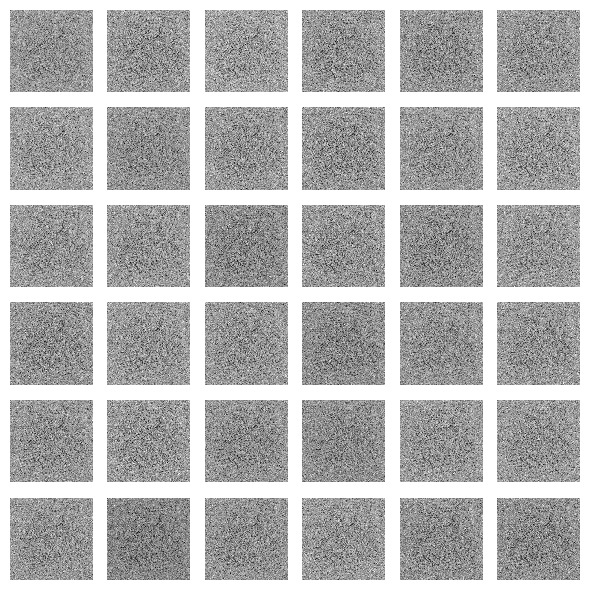

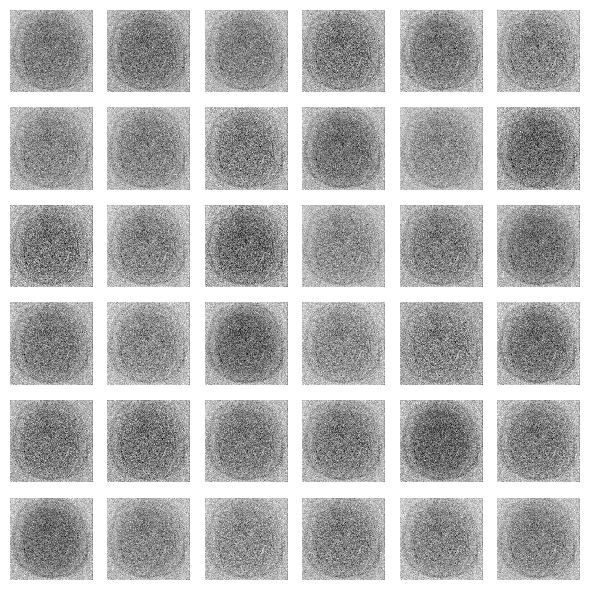

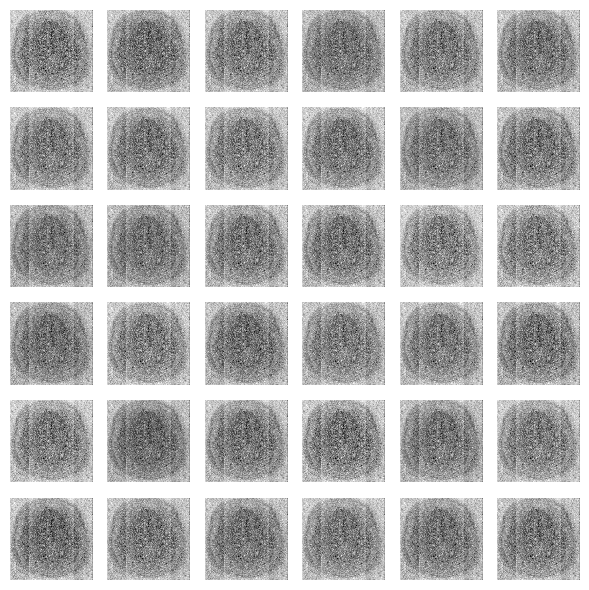

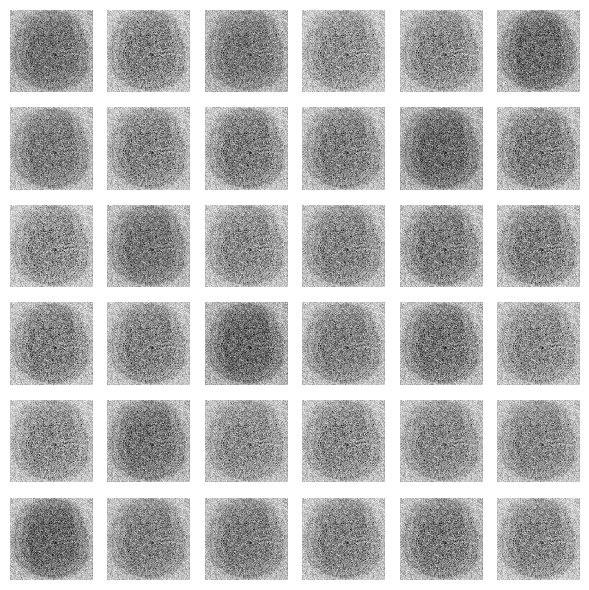

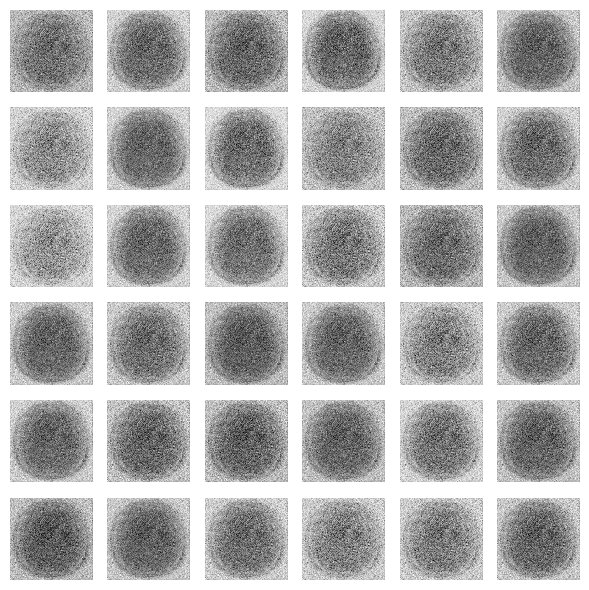

...

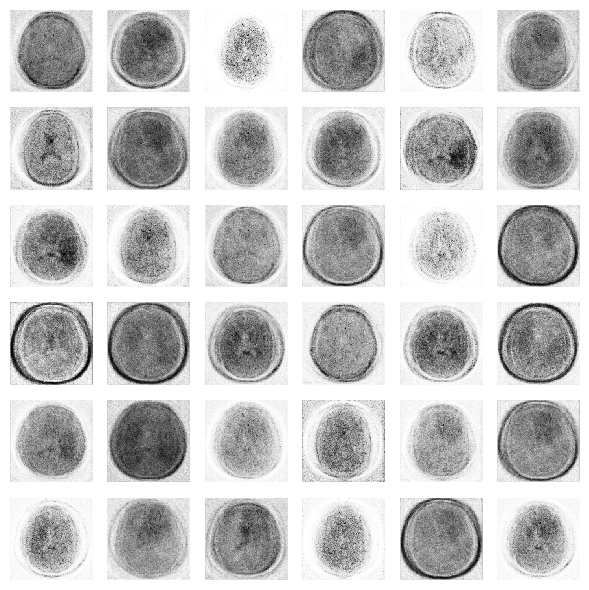

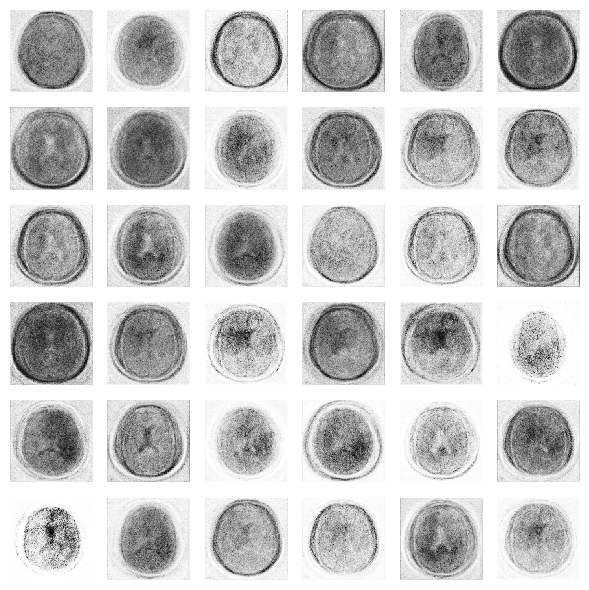

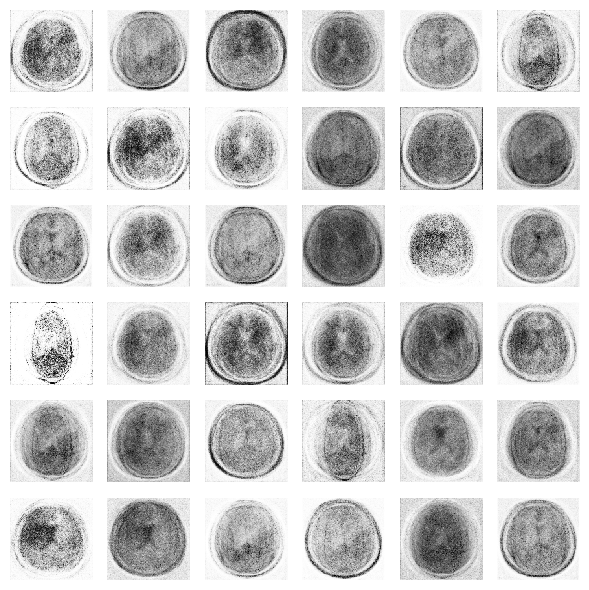

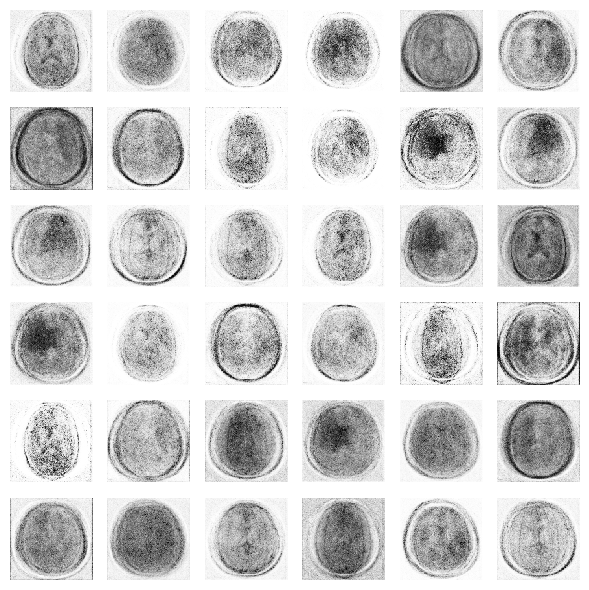

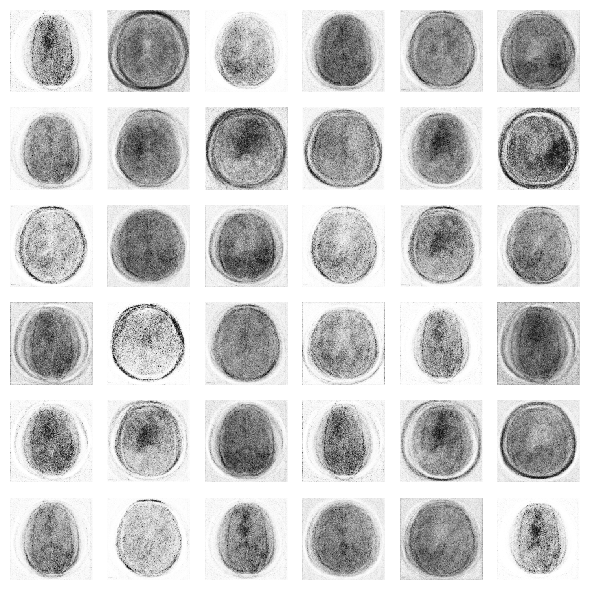

In [25]:
training(epochs=3000)

C:\Users\mohtr\AppData\Local\Temp\ipykernel_12604\2515835468.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(6, 6))


<Figure size 600x600 with 0 Axes>

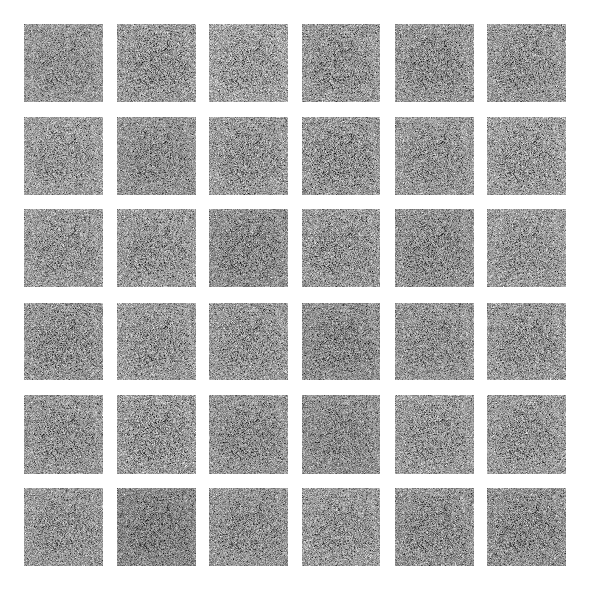

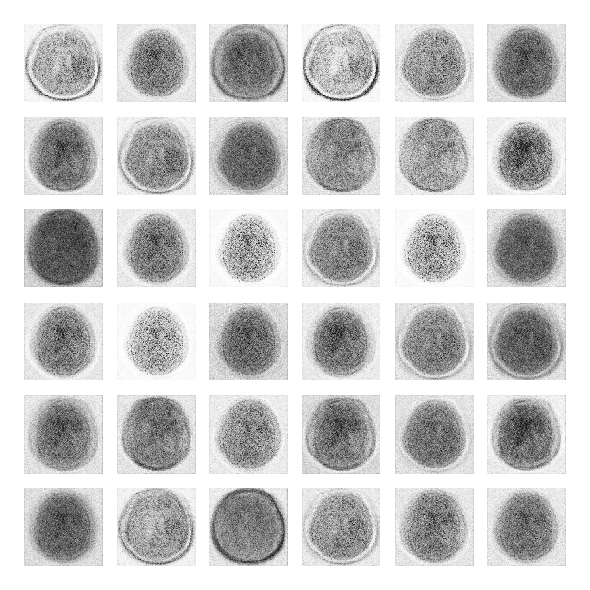

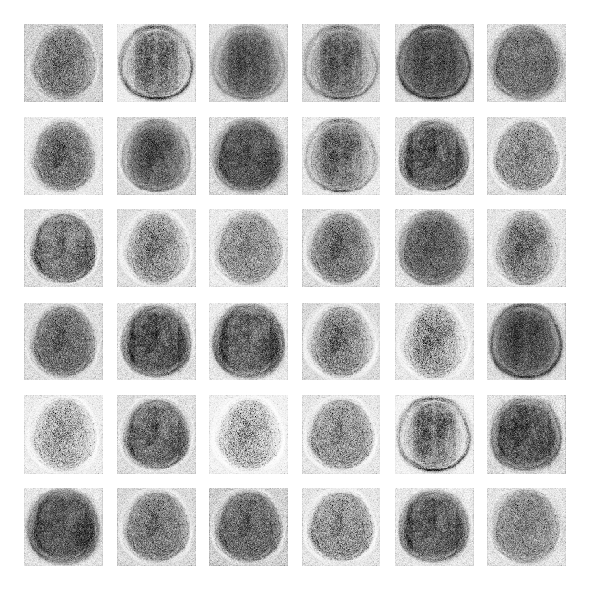

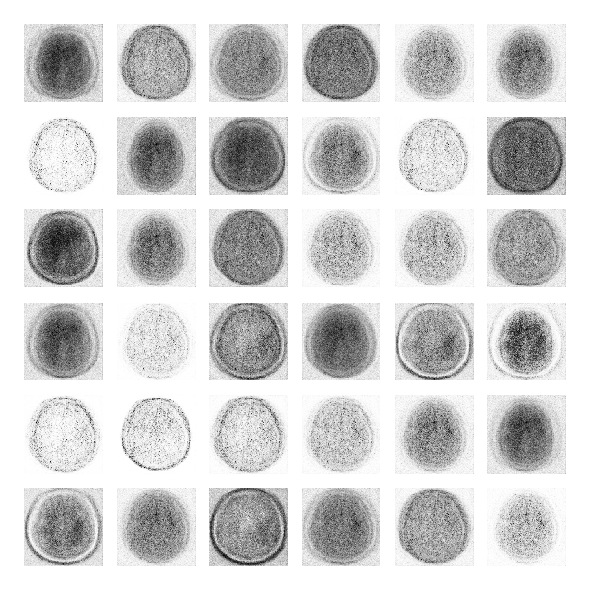

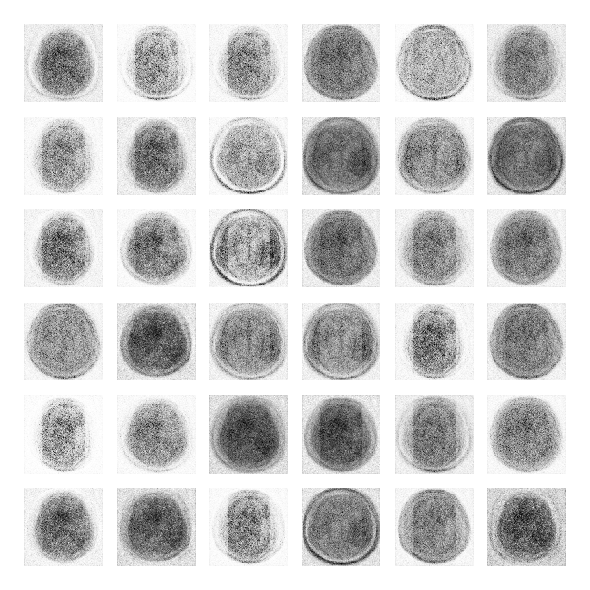

...

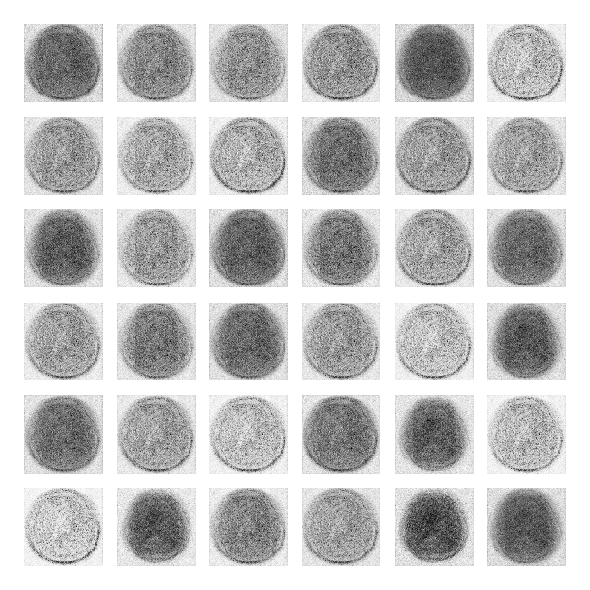

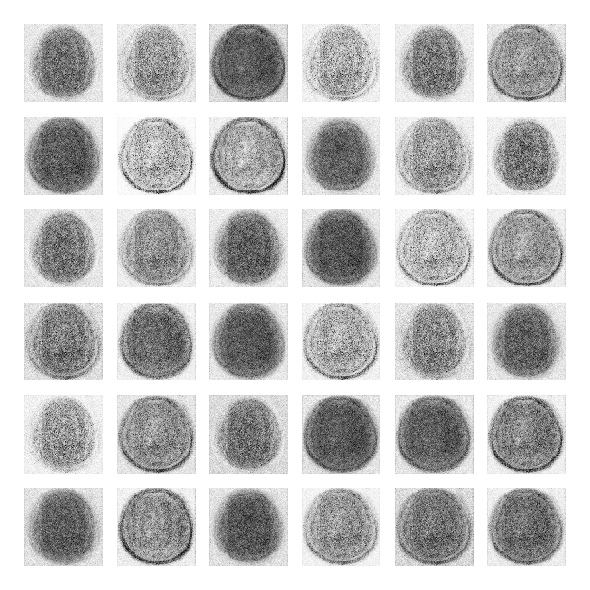

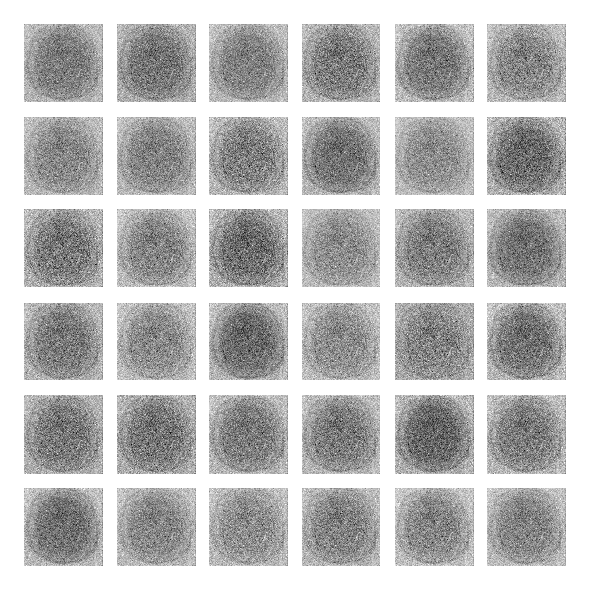

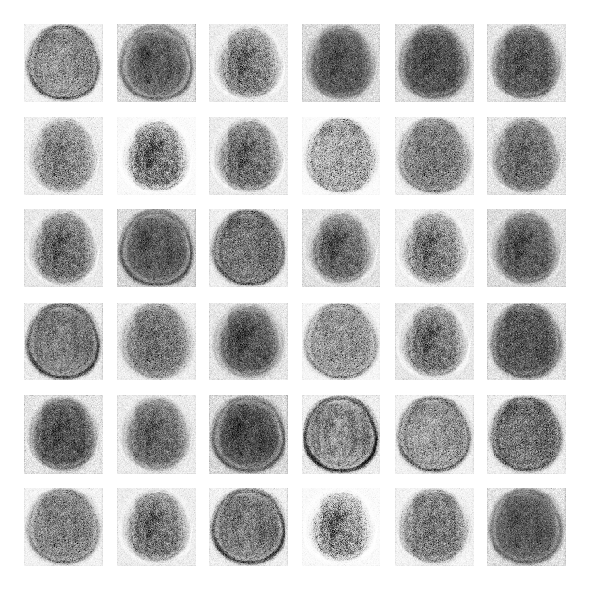

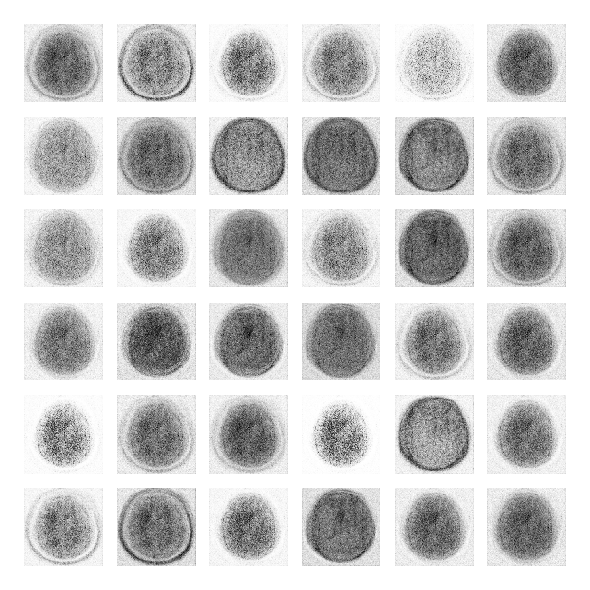

<Figure size 600x600 with 0 Axes>

In [26]:
# Menampilkan gambar hasil yang telah dihasilkan
dir = './'
dirs = os.listdir(dir)
for i in dirs:
    try:
        plt.figure(figsize=(6, 6))
        plt.imshow(plt.imread('./' + i), interpolation='nearest', cmap='gray_r')
        plt.axis('off')
        plt.tight_layout()
    except:
        continue